## Code

In [1]:
%run landsat.py
pd.options.display.max_columns = 100

Cannot find header.dxf (GDAL_DATA is not defined)


### Geometry

In [2]:
url = "http://data.phl.opendata.arcgis.com/datasets/405ec3da942d4e20869d4e1449a2be48_0.geojson"
city_limits = gpd.read_file(url).to_crs(epsg=32618)

Shape Files

In [3]:
shape = "Data/phl_census_block_groups_2010.geojson"
phl_block_groups = gpd.read_file(shape).to_crs(epsg=32618)

In [33]:
phl_block_groups.head() # Check data

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,geometry
0,1,42,101,010800,1,421010108001,Block Group 1,G5030,S,161887,0,+39.9687580,-075.1997251,1.742508e+06,8200.327170,"POLYGON ((483047.282 4424385.239, 483138.583 4..."
1,2,42,101,010800,2,421010108002,Block Group 2,G5030,S,103778,0,+39.9665475,-075.2004455,1.117026e+06,4364.980144,"POLYGON ((483104.517 4423969.564, 482913.923 4..."
2,3,42,101,010900,2,421010109002,Block Group 2,G5030,S,43724,0,+39.9642929,-075.1896435,4.706347e+05,3048.109084,"POLYGON ((483973.375 4423833.388, 483982.128 4..."
3,4,42,101,011000,2,421010110002,Block Group 2,G5030,S,108966,0,+39.9753585,-075.2113476,1.172871e+06,5169.004282,"POLYGON ((482081.555 4424838.514, 481878.506 4..."
4,5,42,101,011000,1,421010110001,Block Group 1,G5030,S,142244,0,+39.9724202,-075.2051689,1.531076e+06,10476.574129,"POLYGON ((483045.331 4424813.111, 483045.608 4..."


### Dates

In [4]:
dates = ["20130601_20200912", "20130719_20200912", "20130820_20200913",
         "20140706_20200911", "20140807_20200911", 
         "20150522_20200909", "20150607_20200909", "20150725_20200908", "20150826_20200908", 
         "20160609_20200906", "20160625_20200906", "20160727_20200906", "20160812_20200906", "20160828_20200906", 
         "20170612_20200903", "20170628_20200903", "20170730_20200903", "20170831_20200903", 
         "20180615_20200831", "20180903_20200831", 
         "20190704_20200827", "20190720_20200827", "20190922_20200826", 
         "20200706_20200913", "20200722_20200911", "20200908_20200919", 
         "20210623_20210630", "20210826_20210901", "20210927_20211001", 
         "20220712_20220722", "20220813_20220823", "20220914_20220922"]

In [5]:
access_dates = []
for day in dates: 
    access, process = day.split("_", 1)
    access_dates.append(access)

In [6]:
# Check dates
print(access_dates[31])
len(access_dates)

20220914


32

#### Removed Dates

In [7]:
# Cloudy Dates
remove = [1, 2, 3, 12, 20, 22, 23, 27, 28, 31] # 2, 19, 24, 25, 26 
data_dates = list(access_dates)
for r in remove:
    data_dates.remove(access_dates[r])

In [8]:
len(data_dates)

22

Convert to Years

In [9]:
years = []
for day in data_dates: 
    year = day[:4]
    years.append(int(year))

# NDVI

Analysis of greening in PHL

## Generation
Converting Landsat TIF images into workable PHL images

In [8]:
for i in range(len(dates)): 
    red = f"Data/Landsat/B4/LC08_L1TP_014032_{dates[i]}_02_T1_B4.TIF"
    nir = f"Data/Landsat/B5/LC08_L1TP_014032_{dates[i]}_02_T1_B5.TIF"
    
    ndvi_file = f"Images/NDVI/ndvi_{access_dates[i]}"
    ndvi_tif(red, nir, ndvi_file)
    ndvi_rio = rio.open(ndvi_file + ".tif")
    
    phl_file = f"Images/NDVI/phl_ndvi_{access_dates[i]}"
    masked_tif(ndvi_rio, city_limits, phl_file)
    phl_rio = rio.open(phl_file + ".tif")
    
    #phl_ndvi.append(phl_rio)
    
    ndvi_rio.close()
    phl_rio.close()

In [12]:
phl_ndvi_files = [f"Images/NDVI/phl_ndvi_{day}.tif" for day in access_dates]

In [142]:
phl_census_ndvi = phl_block_groups
for i in range(len(phl_ndvi_files)):
    geo_stats = stats(phl_block_groups, phl_ndvi_files[i])
    phl_census_ndvi[f"median_{access_dates[i]}"] = geo_stats["median"]
    phl_census_ndvi[f"mean_{access_dates[i]}"] = geo_stats["mean"]
    phl_census_ndvi[f"stdev_{access_dates[i]}"] = geo_stats["std"]
    phl_census_ndvi[f"min_{access_dates[i]}"] = geo_stats["min"]
    phl_census_ndvi[f"max_{access_dates[i]}"] = geo_stats["max"]

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\geodataframe.py:1538: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\geodataframe.py:1538: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  super().__setitem__(key, value)
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\geodataframe.py:1538: PerformanceWarning: DataFrame is highly fragmented.  This

In [143]:
phl_census_ndvi.drop(labels=["median", "mean", "std", "min", "max"], axis=1, inplace=True)

In [144]:
phl_census_ndvi.head()

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,geometry,median_20130601,mean_20130601,stdev_20130601,min_20130601,max_20130601,median_20130719,mean_20130719,stdev_20130719,min_20130719,max_20130719,median_20130820,mean_20130820,stdev_20130820,min_20130820,max_20130820,median_20140706,mean_20140706,stdev_20140706,min_20140706,max_20140706,median_20140807,mean_20140807,stdev_20140807,min_20140807,max_20140807,median_20150607,mean_20150607,stdev_20150607,min_20150607,max_20150607,median_20150725,mean_20150725,stdev_20150725,min_20150725,...,median_20180903,mean_20180903,stdev_20180903,min_20180903,max_20180903,median_20190922,mean_20190922,stdev_20190922,min_20190922,max_20190922,median_20200706,mean_20200706,stdev_20200706,min_20200706,max_20200706,median_20200722,mean_20200722,stdev_20200722,min_20200722,max_20200722,median_20200908,mean_20200908,stdev_20200908,min_20200908,max_20200908,median_20210623,mean_20210623,stdev_20210623,min_20210623,max_20210623,median_20210826,mean_20210826,stdev_20210826,min_20210826,max_20210826,median_20210927,mean_20210927,stdev_20210927,min_20210927,max_20210927,median_20220813,mean_20220813,stdev_20220813,min_20220813,max_20220813,median_20220914,mean_20220914,stdev_20220914,min_20220914,max_20220914
0,1,42,101,010800,1,421010108001,Block Group 1,G5030,S,161887,0,+39.9687580,-075.1997251,1.742508e+06,8200.327170,"POLYGON ((483047.282 4424385.239, 483138.583 4...",0.156846,0.166736,0.115146,0.021293,0.535398,0.074270,0.079243,0.021403,0.031605,0.138094,0.163087,0.174475,0.112856,0.014938,0.479981,0.161493,0.173790,0.104332,0.030812,0.450095,0.162945,0.179256,0.109379,0.019325,0.456090,0.156718,0.168931,0.087058,0.047911,0.416965,0.166374,0.179088,0.121790,0.000245,...,0.146983,0.152415,0.108401,-0.004178,0.495376,0.136286,0.136568,0.079343,0.026835,0.356319,0.083519,0.098348,0.046792,0.042504,0.269158,0.158787,0.161484,0.087687,0.024162,0.401601,0.168993,0.164928,0.101453,0.011917,0.456614,0.175142,0.184964,0.120991,0.004827,0.512622,0.088412,0.109085,0.075108,0.006618,0.466357,0.131503,0.134202,0.085758,0.000000,0.371187,0.153303,0.160048,0.103138,-0.002039,0.456750,0.140959,0.148036,0.102147,-0.010448,0.461164
1,2,42,101,010800,2,421010108002,Block Group 2,G5030,S,103778,0,+39.9665475,-075.2004455,1.117026e+06,4364.980144,"POLYGON ((483104.517 4423969.564, 482913.923 4...",0.204159,0.215523,0.066699,0.086338,0.391882,0.083709,0.086211,0.013997,0.058779,0.118537,0.226022,0.232164,0.067618,0.089559,0.402009,0.226705,0.234323,0.067885,0.114847,0.402584,0.228959,0.241842,0.070373,0.099992,0.436094,0.198255,0.210341,0.053006,0.122305,0.363912,0.232532,0.246045,0.077947,0.076967,...,0.185251,0.203088,0.061410,0.103538,0.396650,0.175057,0.183256,0.050185,0.088180,0.299429,0.157332,0.153090,0.071859,0.051886,0.349992,0.201665,0.204606,0.051772,0.105836,0.329432,0.219671,0.219860,0.062841,0.091936,0.370077,0.236638,0.242227,0.082646,0.095340,0.455401,0.082201,0.092345,0.046063,0.044256,0.345329,0.180454,0.184268,0.058540,0.072134,0.341225,0.204747,0.211227,0.072348,0.055722,0.411669,0.204015,0.203758,0.068192,0.053114,0.376498
2,3,42,101,010900,2,421010109002,Block Group 2,G5030,S,43724,0,+39.9642929,-075.1896435,4.706347e+05,3048.109084,"POLYGON ((483973.375 4423833.388, 483982.128 4...",0.111289,0.114679,0.039880,0.058228,0.231774,0.076823,0.081835,0.016364,0.059478,0.140532,0.123114,0.124345,0.044265,0.049142,0.268837,0.126457,0.135058,0.039311,0.058981,0.263657,0.116053,0.127206,0.041940,0.049189,0.251528,0.115451,0.123543,0.028235,0.077950,0.219953,0.106610,0.115918,0.038683,0.036119,...,0.110118,0.118565,0.022972,0.073646,0.189959,0.097137,0.102570,0.029684,0.036921,0.205865,0.123081,0.128554,0.034391,0.052169,0.239375,0.114028,0.124186,0.032139,0.058522,0.230961,0.106916,0.111786,0.033762,0.044193,0.205025,0.113988,0.123780,0.048282,0.039331,0.282592,0.119880,0.127845,0.041245,0.065030,0.

In [44]:
type(phl_census_ndvi)

geopandas.geodataframe.GeoDataFrame

In [146]:
phl_census_ndvi.to_csv("Data/phl_ndvi_stats_block_groups.csv", index=False)

In [147]:
phl_census_ndvi.to_file("Data/phl_ndvi_stats_block_groups.geojson", driver="GeoJSON")

In [29]:
phl_census_ndvi = gpd.GeoDataFrame(phl_block_groups)
stat = "mean"
for i in range(len(phl_ndvi_files)):
    geo_stats = zonal_stats(phl_block_groups, phl_ndvi_files[i], stats = stat)
    phl_census_ndvi[f"mean_{access_dates[i]}"] = pd.DataFrame([data[stat] for data in geo_stats])

In [34]:
# phl_census_ndvi.drop(labels=["median", "mean", "std", "min", "max"], axis=1, inplace=True)
phl_census_ndvi.head()

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,geometry,mean_20130601,mean_20130719,mean_20130820,mean_20140706,mean_20140807,mean_20150522,mean_20150607,mean_20150725,mean_20150826,mean_20160609,mean_20160625,mean_20160727,mean_20160812,mean_20160828,mean_20170612,mean_20170628,mean_20170730,mean_20170831,mean_20180615,mean_20180903,mean_20190704,mean_20190720,mean_20190922,mean_20200706,mean_20200722,mean_20200908,mean_20210623,mean_20210826,mean_20210927,mean_20220712,mean_20220813,mean_20220914
0,1,42,101,010800,1,421010108001,Block Group 1,G5030,S,161887,0,+39.9687580,-075.1997251,1.742508e+06,8200.327170,"POLYGON ((483047.282 4424385.239, 483138.583 4...",0.166736,0.079243,0.174475,0.173790,0.179256,0.160687,0.168931,0.179088,0.148393,0.171746,0.171317,0.175462,0.174008,0.156867,0.181374,0.179392,0.178398,0.161172,0.176080,0.152415,0.168370,0.193823,0.136568,0.098348,0.161484,0.164928,0.184964,0.109085,0.134202,0.181152,0.160048,0.148036
1,2,42,101,010800,2,421010108002,Block Group 2,G5030,S,103778,0,+39.9665475,-075.2004455,1.117026e+06,4364.980144,"POLYGON ((483104.517 4423969.564, 482913.923 4...",0.215523,0.086211,0.232164,0.234323,0.241842,0.211864,0.210341,0.246045,0.208159,0.234899,0.233999,0.237096,0.231549,0.222081,0.245570,0.246232,0.243567,0.218327,0.244663,0.203088,0.247425,0.253587,0.183256,0.153090,0.204606,0.219860,0.242227,0.092345,0.184268,0.233908,0.211227,0.203758
2,3,42,101,010900,2,421010109002,Block Group 2,G5030,S,43724,0,+39.9642929,-075.1896435,4.706347e+05,3048.109084,"POLYGON ((483973.375 4423833.388, 483982.128 4...",0.114679,0.081835,0.124345,0.135058,0.127206,0.112827,0.123543,0.115918,0.106799,0.120990,0.119809,0.123259,0.050223,0.108014,0.133247,0.131549,0.124880,0.118058,0.122253,0.118565,0.143958,0.137631,0.102570,0.128554,0.124186,0.111786,0.123780,0.127845,0.099289,0.135054,0.119397,0.108213
3,4,42,101,011000,2,421010110002,Block Group 2,G5030,S,108966,0,+39.9753585,-075.2113476,1.172871e+06,5169.004282,"POLYGON ((482081.555 4424838.514, 481878.506 4...",0.167764,0.180329,0.167055,0.145772,0.177588,0.159822,0.168019,0.169162,0.149725,0.171299,0.166614,0.171820,0.171949,0.153994,0.175467,0.172537,0.165590,0.159460,0.176031,0.168929,0.094047,0.183348,0.135613,0.109650,0.163137,0.150277,0.164711,0.107521,0.124110,0.162817,0.140600,0.135514
4,5,42,101,011000,1,421010110001,Block Group 1,G5030,S,142244,0,+39.9724202,-075.2051689,1.531076e+06,10476.574129,"POLYGON ((483045.331 4424813.111, 483045.608 4...",0.218008,0.101490,0.217960,0.202691,0.226679,0.220396,0.221777,0.223241,0.190623,0.229832,0.221314,0.224670,0.220355,0.205843,0.243017,0.241879,0.233041,0.214003,0.247027,0.216747,0.092897,0.249988,0.178240,0.118729,0.208390,0.200052,0.240398,0.125346,0.183422,0.235561,0.215752,0.202159


In [35]:
phl_census_ndvi.to_csv("Data/phl_ndvi_block_groups_mean.csv", index=False)
phl_census_ndvi.to_file("Data/phl_ndvi_block_groups_mean.geojson", driver="GeoJSON")

## Data
Visualization

In [7]:
# Removing low quality images
test_remove = [1, 12, 19, 20, 22, 23, 24, 27, 28] # 3?,5?,11?,13?,19?

In [210]:
phl_ndvi_img = []
for i in access_dates:
    phl_rio = rio.open("Images/NDVI/phl_ndvi_" + i + ".tif")
    phl_ndvi_img.append(phl_rio)

In [ ]:
index = 20
ndvi_fig, ndvi_ax = geo_plot(phl_ndvi_img[index], city_limits, "NDVI on " + access_dates[index], "Greens")

### Geojson

In [7]:
phl_ndvi_stats_geo = gpd.read_file("Data/phl_ndvi_block_groups_mean.geojson") # phl_ndvi_stats_block_groups

In [116]:
alt.Chart(phl_ndvi_stats_geo.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["mean_20130820:Q",
                                                                                        "OBJECTID:N"],
                                                                color=alt.Color("mean_20130820:Q", 
                                                                                scale=alt.Scale(scheme="greens")),
                                                               ).properties(width=500, height=500)
# "median_20150826:Q",

alt.Chart(...)

In [154]:
(phl_ndvi_stats_geo["mean_20220813"] - phl_ndvi_stats_geo["mean_20130719"]).describe()

count    1336.000000
mean        0.025017
std         0.059817
min        -0.095768
25%        -0.019580
50%         0.003858
75%         0.059379
max         0.299889
dtype: float64

## Analysis

In [10]:
phl_ndvi_stats_csv = pd.read_csv("Data/phl_ndvi_block_groups_mean.csv") # phl_ndvi_stats_block_groups

### City-Wide

#### Temporal

In [27]:
phl_mean = []
# phl_stdev_median = []
for i in access_dates:
    phl_mean.append(np.mean(phl_ndvi_stats_csv["mean_"+i]))
    # phl_stdev_median.append(np.median(phl_ndvi_stats_csv["stdev_"+i]))

In [28]:
np.mean(phl_mean)

0.16861443848314367

In [165]:
np.array(phl_mean) - np.array(phl_median)

array([0.01085975, 0.006265  , 0.00906619, 0.00920449, 0.00970672,
       0.00971043, 0.01067324, 0.0092963 , 0.01129698, 0.01135939,
       0.01013801, 0.01008279, 0.01012123, 0.01094127, 0.01138653,
       0.01050044, 0.00903637, 0.00966262, 0.00815944, 0.00950151,
       0.00895195, 0.00974474, 0.01224499, 0.0070816 , 0.00982925,
       0.01075405, 0.01037337])

In [84]:
np.array(phl_ndvi_stats_csv["mean_20220813"].describe()) # 20130719  20130601

array([1.33600000e+03, 1.64137471e-01, 7.65645352e-02, 1.79607130e-02,
       1.08410720e-01, 1.48842345e-01, 2.08661735e-01, 4.72713187e-01])

<Axes: >

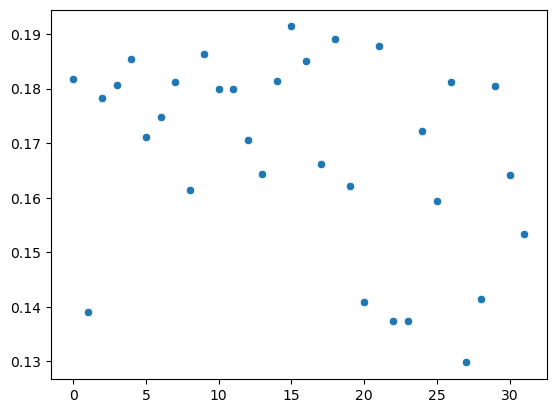

In [40]:
sns.scatterplot(data=phl_mean) # x="NDVI", y="Time"

<Axes: >

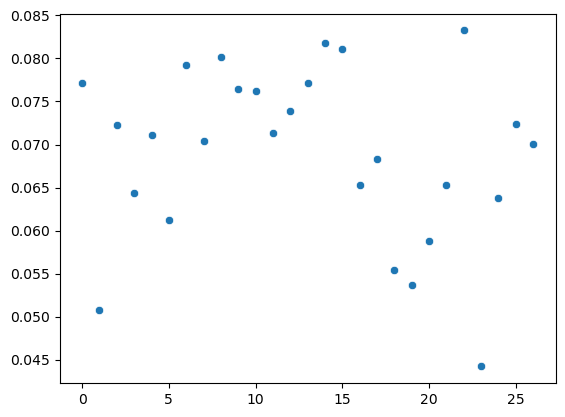

In [127]:
sns.scatterplot(data=phl_stdev_median)

In [10]:
phl_mean = []
city_ndvi_mean = []
# phl_stdev_median = []
for i in data_dates:
    phl_mean.append(np.mean(phl_ndvi_stats_csv["mean_"+i]))
    # phl_stdev_median.append(np.median(phl_ndvi_stats_csv["stdev_"+i]))
    city = zonal_stats(city_limits, f"Images/NDVI/phl_ndvi_{i}.tif", stats=["mean"])
    city_ndvi_mean.append(city[0]["mean"])

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\rasterstats\io.py:328: NodataWarning: Setting nodata to -999; specify nodata explicitly
  warnings.warn(


In [11]:
np.mean(city_ndvi_mean)

0.22375209896027026

<Axes: >

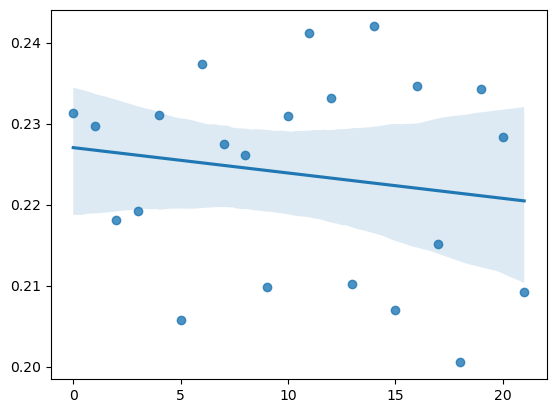

In [15]:
sns.regplot(x=[range(len(data_dates))],y=city_ndvi_mean)

<Axes: >

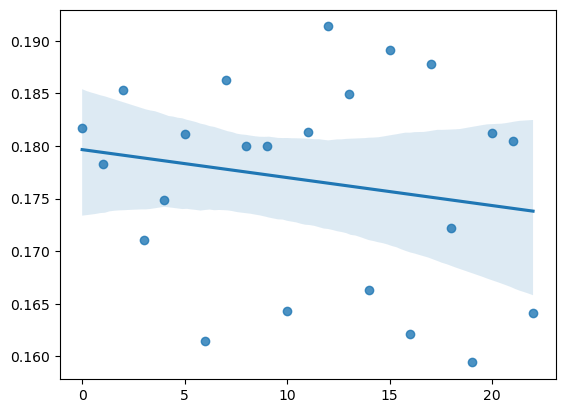

In [24]:
sns.regplot(x=[range(len(data_dates))],y=phl_mean)

In [17]:
yearly_ndvi = pd.DataFrame({"Year":years, "Mean NDVI":city_ndvi_mean}) #phl_mean

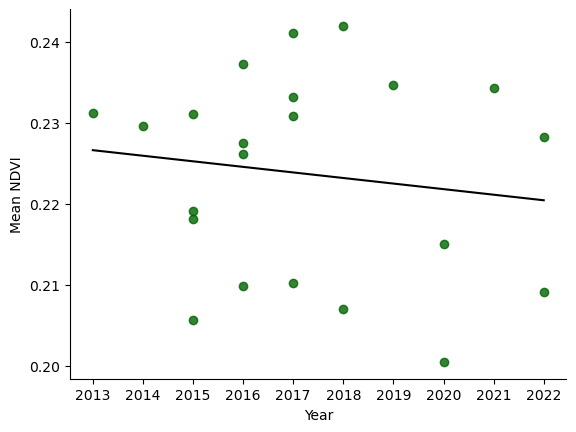

In [33]:
city_ndvi = sns.regplot(data=yearly_ndvi, x ="Year", y = "Mean NDVI", color="darkgreen", 
                        line_kws=dict(color="black", lw=1.5), ci=None,)
city_ndvi.set_xticks(range(min(yearly_ndvi["Year"]), max(yearly_ndvi["Year"]) + 1))
city_ndvi.set_ylabel("Mean NDVI")
sns.despine()

#plt.savefig("Graphs/phl_city_ndvi_mean.pdf")

In [228]:
phl_group_ndvi = []
for day in data_dates:
    phl_group_ndvi.append(phl_ndvi_stats_csv["mean_" + day])

In [229]:
phl_mean_ndvi = pd.DataFrame(phl_group_ndvi).T
phl_mean_ndvi.columns = years # data_dates
phl_mean_ndvi.head()

,2013,2014,2015,2015,2015,2015,2016,2016,2016,2016,2017,2017,2017,2017,2018,2018,2019,2020,2020,2021,2022,2022
0,0.166736,0.179256,0.160687,0.168931,0.179088,0.148393,0.171746,0.171317,0.175462,0.156867,0.181374,0.179392,0.178398,0.161172,0.176080,0.152415,0.193823,0.161484,0.164928,0.184964,0.181152,0.160048
1,0.215523,0.241842,0.211864,0.210341,0.246045,0.208159,0.234899,0.233999,0.237096,0.222081,0.245570,0.246232,0.243567,0.218327,0.244663,0.203088,0.253587,0.204606,0.219860,0.242227,0.233908,0.211227
2,0.114679,0.127206,0.112827,0.123543,0.115918,0.106799,0.120990,0.119809,0.123259,0.108014,0.133247,0.131549,0.124880,0.118058,0.122253,0.118565,0.137631,0.124186,0.111786,0.123780,0.135054,0.119397
3,0.167764,0.177588,0.159822,0.168019,0.169162,0.149725,0.171299,0.166614,0.171820,0.153994,0.175467,0.172537,0.165590,0.159460,0.176031,0.168929,0.183348,0.163137,0.150277,0.164711,0.162817,0.140600
4,0.218008,0.226679,0.220396,0.221777,0.223241,0.190623,0.229832,0.221314,0.224670,0.205843,0.243017,0.241879,0.233041,0.214003,0.247027,0.216747,0.249988,0.208390,0.200052,0.240398,0.235561,0.215752


<Axes: >

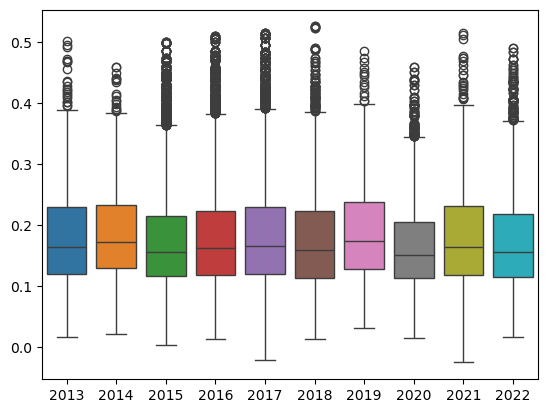

In [230]:
sns.boxplot(phl_mean_ndvi)

##### Lin Reg

In [12]:
# Block group level NDVI averages
block_group_ndvi_mean = phl_ndvi_stats_csv.loc[:, [f"mean_{day}" for day in data_dates]]

In [30]:
phl_ndvi_reg = lm.LinearRegression()
phl_ndvi_reg.fit([[i] for i in range(len(data_dates))], yearly_ndvi["Mean NDVI"].values.reshape(-1, 1))

LinearRegression()

In [31]:
print(phl_ndvi_reg.coef_)
print(phl_ndvi_reg.intercept_)

[[-0.00042408]]
[0.18140509]


In [43]:
phl_ndvi_reg_year = lm.LinearRegression()
phl_ndvi_reg_year.fit([[i-2013] for i in yearly_ndvi["Year"]], yearly_ndvi["Mean NDVI"].values.reshape(-1, 1))

LinearRegression()

In [44]:
print(phl_ndvi_reg_year.coef_)
print(phl_ndvi_reg_year.intercept_)

[[-0.00111347]]
[0.18107477]


In [34]:
ndvi_model = sm.OLS(yearly_ndvi["Mean NDVI"].values.reshape(-1, 1), sm.add_constant([[i-2013] for i in yearly_ndvi["Year"]]))
ndvi_results = ndvi_model.fit()
print(ndvi_results.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.020
Model:                            OLS   Adj. R-squared:                 -0.029
Method:                 Least Squares   F-statistic:                    0.3986
Date:                Sat, 11 May 2024   Prob (F-statistic):              0.535
Time:                        10:16:30   Log-Likelihood:                 66.072
No. Observations:                  22   AIC:                            -128.1
Df Residuals:                      20   BIC:                            -126.0
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.2267      0.005     42.545      0.0

In [35]:
ndvi_results.params

array([ 0.22665712, -0.00068721])

<Axes: >

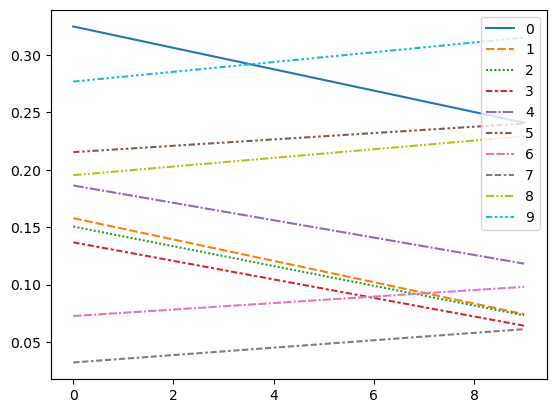

In [210]:
extreme = [617, 718, 500, 467, 120, 1173, 256, 428, 277, 954] #10:20 861
intercept = np.outer(np.ones(10),np.array(param)[extreme, 0])
slope = np.outer(np.array([i for i in range(10)]), np.array(param)[extreme,1])
sns.lineplot(intercept+slope) # Plots columns of array

In [86]:
np.array(t)[:,1]

array([-0.16566365, -0.56132762,  0.30577554, ..., -1.44852207,
       -3.41429871, -1.0964196 ])

In [59]:
phl_ndvi_params = gpd.GeoDataFrame(phl_block_groups)
phl_ndvi_params["Intercept"] = np.array(param)[:,0]
phl_ndvi_params["Slope"] = np.array(param)[:,1]
phl_ndvi_params["Slope t-value"] = np.array(t)[:,1]

In [60]:
phl_ndvi_params["Sig Slope"] = np.multiply(np.abs(phl_ndvi_params["Slope t-value"]) > 1.96, phl_ndvi_params["Slope"])

In [ ]:
phl_ndvi_params["Slope"].describe()

In [114]:
phl_ndvi_params.tail()

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,geometry,Intercept,Slope,Slope t-value,Sig Slope
1331,1332,42,101,016200,2,421010162002,Block Group 2,G5030,S,223441,0,+39.9843381,-075.1407049,2.405057e+06,6772.642577,"POLYGON ((487748.279 4426244.635, 487804.613 4...",0.187030,0.000328,0.319326,0.000000
1332,1333,42,101,015600,2,421010156002,Block Group 2,G5030,S,177448,0,+39.9806576,-075.1425322,1.909996e+06,6128.309258,"POLYGON ((487958.845 4425505.326, 487930.490 4...",0.189851,-0.004090,-4.093824,-0.004090
1333,1334,42,101,015700,3,421010157003,Block Group 3,G5030,S,305254,0,+39.9768522,-075.1353407,3.285646e+06,9381.401996,"POLYGON ((488201.019 4425463.770, 488209.982 4...",0.121968,-0.000497,-0.728148,-0.000000
1334,1335,42,101,017900,5,421010179005,Block Group 5,G5030,S,275799,0,+39.9858493,-075.1177472,2.968631e+06,9625.938356,"POLYGON ((490129.475 4425938.838, 490092.508 4...",0.185046,-0.003896,-2.728342,-0.003896
1335,1336,42,101,017800,6,421010178006,Block Group 6,G5030,S,138969,0,+39.9886847,-075.1207112,1.489867e+06,6889.853029,"POLYGON ((490032.370 4426505.125, 489982.894 4...",0.179663,-0.001660,-1.407422,-0.000000


In [162]:
alt.Chart(phl_ndvi_params.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["Intercept:Q", "Slope:Q", "OBJECTID:N"],
                                                                            color=alt.Color("Intercept:Q",
                                                                                            scale=alt.Scale(scheme="greens")),
                                                                           ).properties(width=500, height=500)

alt.Chart(...)

In [84]:
alt.Chart(phl_ndvi_params.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["Slope:Q", "Slope t-value:Q", "OBJECTID:N"],
                                                                            color=alt.Color("Slope:Q",
                                                                                            scale=alt.Scale(domain=[-.009,.009],
                                                                                                scheme="purplegreen")),
                                                                           ).properties(width=500, height=500)

alt.Chart(...)

In [277]:
alt.Chart(phl_ndvi_params.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["Intercept:Q", "Sig Slope:Q", "OBJECTID:N"],
                                                                            color=alt.Color("Sig Slope:Q", 
                                                                                            scale=alt.Scale(domain=[-.009,.009],
                                                                                                scheme="purplegreen")),
                                                                           ).properties(width=500, height=500)

alt.Chart(...)

###### All Neighborhoods

In [13]:
y_ndvi = block_group_ndvi_mean.T.melt(value_vars = range(len(phl_block_groups)))

In [68]:
x_time = np.zeros((len(data_dates)*len(phl_block_groups), 2*len(phl_block_groups)))
start_year = 2013
for i in range(len(phl_block_groups)):
    a = i*len(data_dates)
    b = (i+1)*len(data_dates)
    x_time[a:b, i] = np.ones(len(data_dates))
    x_time[a:b, i+len(phl_block_groups)] = [(i-start_year) for i in years]

In [17]:
ndvi_model = sm.OLS(y_ndvi["value"].values.reshape(-1, 1), x_time)
ndvi_results = ndvi_model.fit()
# print(ndvi_results.summary())

In [20]:
np.sum(ndvi_results.params[0:1336] - phl_ndvi_params["Intercept"])

0.2071796311027892

In [265]:
np.sum(np.abs(ndvi_results.tvalues[1336:]) > 1.96) # 147

136

In [266]:
np.sum(ndvi_results.tvalues[1336:] > 1.96) # 13
# np.sum((ndvi_results.params[1336:] > 0) & (np.abs(ndvi_results.tvalues[1336:]) > 1.96))

7

##### Parameters

In [14]:
phl_ndvi_params = gpd.read_file("Data/phl_ndvi_OLS.geojson")
phl_ndvi_params.head()

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,Intercept,Slope,Slope t-value,Sig Slope,geometry
0,1,42,101,010800,1,421010108001,Block Group 1,G5030,S,161887,0,+39.9687580,-075.1997251,1.742508e+06,8200.327170,0.167661,0.000701,0.545164,0.0,"POLYGON ((483047.282 4424385.239, 483138.583 4..."
1,2,42,101,010800,2,421010108002,Block Group 2,G5030,S,103778,0,+39.9665475,-075.2004455,1.117026e+06,4364.980144,0.228214,0.000086,0.066861,0.0,"POLYGON ((483104.517 4423969.564, 482913.923 4..."
2,3,42,101,010900,2,421010109002,Block Group 2,G5030,S,43724,0,+39.9642929,-075.1896435,4.706347e+05,3048.109084,0.116682,0.001144,0.890227,0.0,"POLYGON ((483973.375 4423833.388, 483982.128 4..."
3,4,42,101,011000,2,421010110002,Block Group 2,G5030,S,108966,0,+39.9753585,-075.2113476,1.172871e+06,5169.004282,0.170453,-0.001196,-0.930687,-0.0,"POLYGON ((482081.555 4424838.514, 481878.506 4..."
4,5,42,101,011000,1,421010110001,Block Group 1,G5030,S,142244,0,+39.9724202,-075.2051689,1.531076e+06,10476.574129,0.219546,0.001056,0.821560,0.0,"POLYGON ((483045.331 4424813.111, 483045.608 4..."


C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


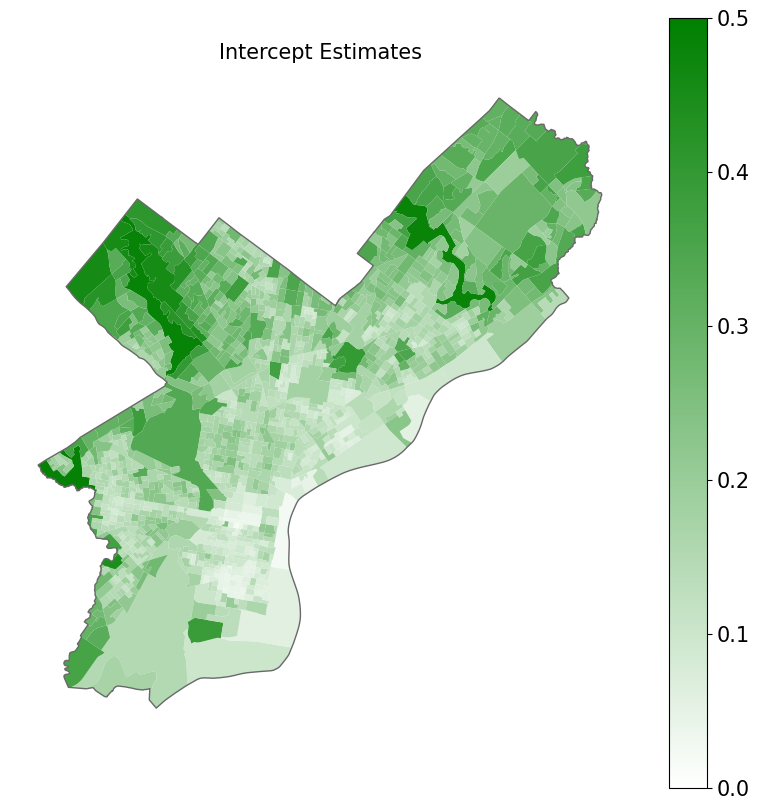

In [12]:
fig_phl_ndvi_int, ax_phl_ndvi_int = plt.subplots(figsize=(10,10))

phl_block_groups.plot(ax=ax_phl_ndvi_int, edgecolor="silver", facecolor="none", linewidth=0.01)
colors = color.LinearSegmentedColormap.from_list("ndvi_map", ["White", "Green"])
phl_ndvi_params.plot("Intercept", ax = ax_phl_ndvi_int, cmap = colors,
                     label="Intercepts", norm=plt.Normalize(vmin=0, vmax=0.5), 
                     legend = True,) # legend_kwds={"shrink":1.5}
ax_phl_ndvi_int.set_title("Intercept Estimates", fontsize=15)

# Change colorbar axis
cbar = ax_phl_ndvi_int.figure.axes[1] 
cbar.tick_params(labelsize=15)

city_limits.plot(ax=ax_phl_ndvi_int, edgecolor="dimgray", facecolor="none", linewidth=1)
ax_phl_ndvi_int.set_axis_off()

#fig_phl_ndvi_int.savefig("Graphs/phl_NDVI_Time_intercepts.pdf")

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


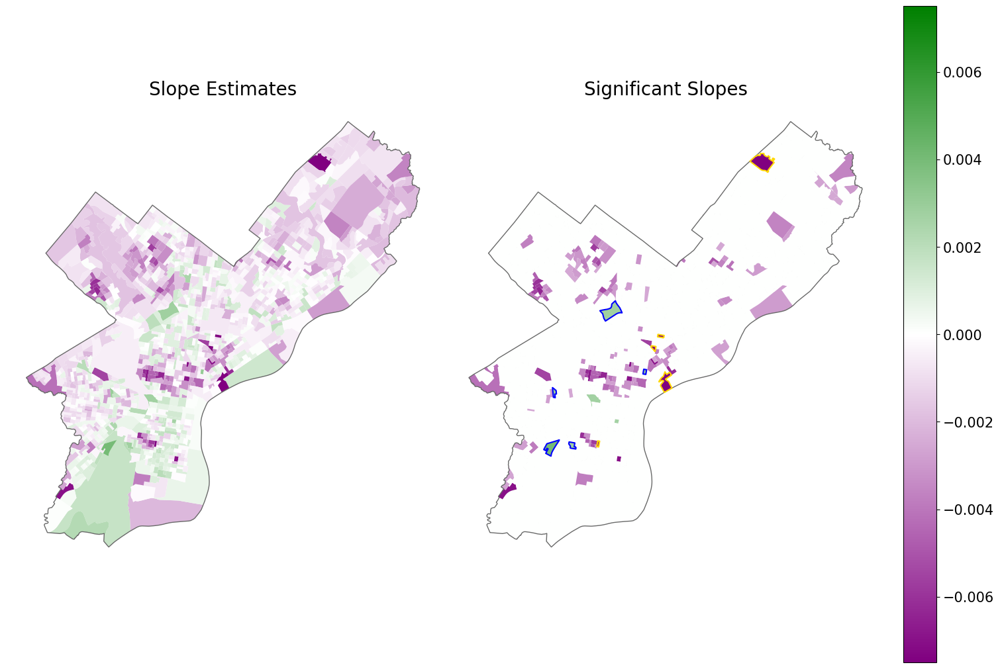

In [12]:
fig_phl_ndvi, ax_phl_ndvi = plt.subplots(figsize=(15,10), nrows=1, ncols=2, layout="constrained")

# Plot NDVI regions
colors = color.LinearSegmentedColormap.from_list("ndvi_map", ["Purple", "White", "Green"])
phl_ndvi_params.plot("Slope", ax = ax_phl_ndvi[0], cmap = colors,
                     label="Slopes", norm=plt.Normalize(-.0075,.0075))
ax_phl_ndvi[0].set_title("Slope Estimates", fontsize=20)

phl_ndvi_params.plot("Sig Slope", ax = ax_phl_ndvi[1], cmap = colors, label="Sig Slopes", 
                     norm=plt.Normalize(-.0075,.0075), legend=True)
ax_phl_ndvi[1].set_title("Significant Slopes", fontsize=20)
phl_block_groups.plot(ax=ax_phl_ndvi[1], edgecolor="whitesmoke", facecolor="none", linewidth=0.0001)

cbar = ax_phl_ndvi[1].figure.axes[2] 
cbar.tick_params(labelsize=15)

# Format and plot city limits
for i in range(2):
    city_limits.plot(ax=ax_phl_ndvi[i], edgecolor="dimgray", facecolor="none", linewidth=1)
    ax_phl_ndvi[i].set_axis_off()
phl_ndvi_params.sort_values(["Sig Slope"])[0:5].plot(ax=ax_phl_ndvi[1], edgecolor="gold", facecolor="none", linewidth=1.5)
phl_ndvi_params.sort_values(["Sig Slope"])[-5:].plot(ax=ax_phl_ndvi[1], edgecolor="blue", facecolor="none", linewidth=1.5)

# fig_phl_ndvi.suptitle("OLS Estimations from 2013-2022", fontsize=25)
# fig_phl_ndvi.savefig("Graphs/phl_NDVI_Time_slopes.pdf")

In [152]:
phl_ndvi_params.sort_values(["Sig Slope"])[0:5].plot(ax=ax_phl_ndvi[1], edgecolor="blue", facecolor="none", linewidth=1.5)

<Axes: title={'center': 'Significant Slopes'}>

<Figure size 640x480 with 0 Axes>

In [55]:
slope_intercept_model = sm.OLS(phl_ndvi_params["Slope"].values.reshape(-1, 1), 
                               sm.add_constant(phl_ndvi_params["Intercept"].values.reshape(-1, 1)))
slope_intercept_results = slope_intercept_model.fit()
print(slope_intercept_results.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.101
Model:                            OLS   Adj. R-squared:                  0.100
Method:                 Least Squares   F-statistic:                     149.6
Date:                Tue, 29 Oct 2024   Prob (F-statistic):           1.13e-32
Time:                        17:25:43   Log-Likelihood:                 6826.2
No. Observations:                1336   AIC:                        -1.365e+04
Df Residuals:                    1334   BIC:                        -1.364e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.0005   9.73e-05      4.702      0.0

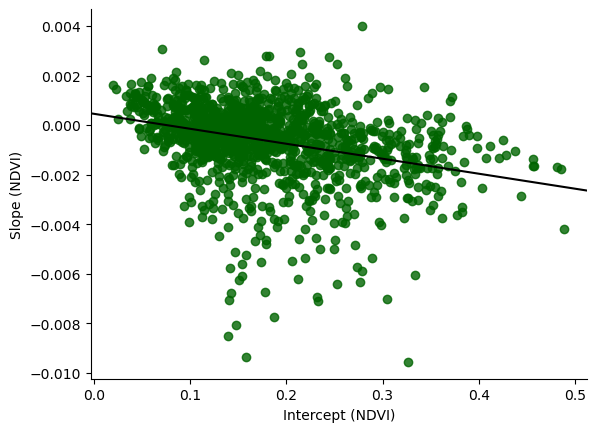

In [40]:
# Slope vs Intercept
slope_intercept_plot = sns.regplot(data=phl_ndvi_params, x ="Intercept", y = "Slope", color="darkgreen",
                                   line_kws=dict(color="black", lw=1.5), truncate=False, ci=None,)
# Sig Slopes
#sns.scatterplot(data=phl_ndvi_params.loc[phl_ndvi_params["Sig Slope"] != 0,], x ="Intercept", y = "Sig Slope",
#                color = "pink", linewidth=0, size=0.95, legend=False) 
slope_intercept_plot.set_xticks([i/10 for i in range(0,6)])
slope_intercept_plot.set_xlabel("Intercept (NDVI)")
slope_intercept_plot.set_ylabel("Slope (NDVI)")
# slope_intercept.set_ylabel("Slopes")
sns.despine()
#plt.savefig("Graphs/phl_NDVI_Time_slopes_intercepts.pdf")

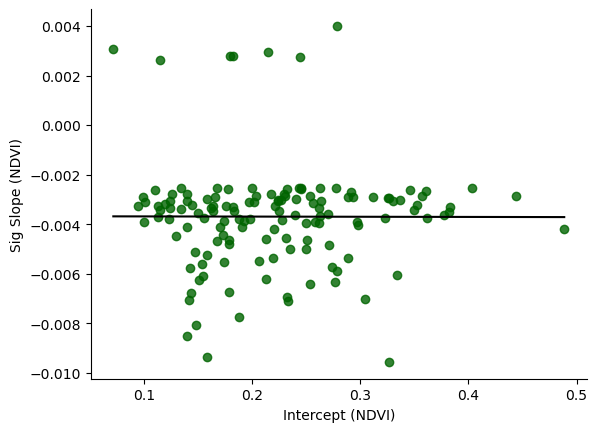

In [41]:
# Sig Slope vs Intercept
slope_intercept = sns.regplot(data=phl_ndvi_params.loc[phl_ndvi_params["Sig Slope"] != 0], x ="Intercept", y = "Sig Slope", 
                              color="darkgreen", line_kws=dict(color="black", lw=1.5), ci=None,)
# slope_intercept.set_xticks(range(min(yearly_ndvi["Year"]), max(yearly_ndvi["Year"]) + 1))
# slope_intercept.set_ylabel("Slopes")
slope_intercept.set_xlabel("Intercept (NDVI)")
slope_intercept.set_ylabel("Sig Slope (NDVI)")
sns.despine()
#plt.savefig("Graphs/phl_NDVI_Time_sig_slopes_intercepts.pdf")

In [59]:
sig_slope_intercept_model = sm.OLS(phl_ndvi_params.loc[phl_ndvi_params["Sig Slope"] != 0, "Sig Slope"].values.reshape(-1, 1), 
                               sm.add_constant(phl_ndvi_params.loc[phl_ndvi_params["Sig Slope"] != 0, "Intercept"].values.reshape(-1, 1)))
sig_slope_intercept_results = sig_slope_intercept_model.fit()
print(sig_slope_intercept_results.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.007
Method:                 Least Squares   F-statistic:                 0.0009351
Date:                Tue, 29 Oct 2024   Prob (F-statistic):              0.976
Time:                        17:29:44   Log-Likelihood:                 642.55
No. Observations:                 136   AIC:                            -1281.
Df Residuals:                     134   BIC:                            -1275.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0037      0.001     -6.755      0.0

##### Significance

In [28]:
sum(np.abs(phl_ndvi_params["Slope t-value"]) > 1.96) 

136

In [29]:
# Positive Slopes
print(sum(phl_ndvi_params["Slope"] > 0))
sum((phl_ndvi_params["Slope"] > 0) & (np.abs(phl_ndvi_params["Slope t-value"]) > 1.96)) 

458


7

#### Spatial

In [125]:
phl_ndvi_stats_csv["stdev_20190922"].median()

0.0554354334653252

##### Spatial Correlation

In [68]:
from pysal.lib import weights
from pysal.model import spreg

In [37]:
phl_weights = weights.Queen.from_dataframe(phl_block_groups, ids = "OBJECTID")
phl_weights.transform = "r"

In [114]:
#test_w = weights.W({1:phl_weights.neighbors[2]})

KeyError: 1

In [47]:
bg_ndvi = block_group_ndvi_mean.iloc[1]

In [102]:
sp_ols = spreg.OLS(y=bg_ndvi.values.reshape(-1, 1), x=yearly_ndvi["Year"].values.reshape(-1, 1), 
                   name_y="NDVI", name_x = ["Year"])
# w=phl_weights[1], spat_diag=True,

In [104]:
print(sp_ols.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :        None
Dependent Variable  :        NDVI                Number of Observations:          24
Mean dependent var  :      0.2290                Number of Variables   :           2
S.D. dependent var  :      0.0155                Degrees of Freedom    :          22
R-squared           :      0.0141
Adjusted R-squared  :     -0.0307
Sum squared residual:  0.00542527                F-statistic           :      0.3151
Sigma-square        :       0.000                Prob(F-statistic)     :      0.5802
S.E. of regression  :       0.016                Log likelihood        :      66.682
Sigma-square ML     :       0.000                Akaike info criterion :    -129.365
S.E of regression ML:      0.0150                Schwarz criterion     :    -127.009

------------------------------------------------------------

In [22]:
sp_ols_reg = spreg.OLS_Regimes(y=np.array(block_group_ndvi_mean), 
                               x=np.repeat(np.array([yearly_ndvi["Year"] - 2013]), 1336, axis=0), 
                               regimes=phl_block_groups.OBJECTID,
                               name_y="NDVI", name_x = ["Year"], name_regimes=phl_block_groups.OBJECTID)


Exception: y must be a single column array matching the length of other arrays

In [23]:
sp_panel= spreg.Panel_FE_Lag(y=np.array(block_group_ndvi_mean), x=np.repeat(np.array([yearly_ndvi["Year"]-2013]), 1336, axis=0), 
                             w=phl_weights)

ValueError: cannot reshape array of size 0 into shape (32064,1)

In [25]:
#np.repeat(np.array([yearly_ndvi["Year"] - 2013]), 1336, axis=0)
np.array(block_group_ndvi_mean).shape

(1336, 24)

In [37]:
type(phl_weights[2])

dict

In [156]:
ndvi_lag = weights.lag_spatial(phl_weights, block_group_ndvi_mean)
ndvi_lag = pd.DataFrame(ndvi_lag).T.melt(value_vars = range(len(phl_block_groups)))

In [102]:
ndvi_spatial = sm.OLS(ndvi_lag["value"].values.reshape(-1, 1), x_time)
ndvi_spatial_results = ndvi_spatial.fit()

In [112]:
np.sum(np.abs(ndvi_spatial_results.tvalues[1336:]) > 1.96)

98

In [127]:
np.sum(ndvi_spatial_results.params[1336:] - ndvi_results.params[1336:])

0.01800229231892794

In [163]:
phl_ndvi_params["Spatial Intercept"] = ndvi_spatial_results.params[0:1336] 
phl_ndvi_params["Spatial Slope"] = ndvi_spatial_results.params[1336:]

In [164]:
alt.Chart(phl_ndvi_params.to_crs(4326)).mark_geoshape(
    stroke="gray").encode(tooltip=["Spatial Intercept:Q", "Intercept:Q", "OBJECTID:N"],
                          color=alt.Color("Spatial Intercept:Q",
                                          scale=alt.Scale(scheme="greens")),
                         ).properties(width=500, height=500)

alt.Chart(...)

In [166]:
alt.Chart(phl_ndvi_params.to_crs(4326)).mark_geoshape(
    stroke="gray").encode(tooltip=["Spatial Slope:Q", "Slope:Q", "OBJECTID:N"],
                          color=alt.Color("Spatial Slope:Q",
                                          scale=alt.Scale(domain=[-.005,.005],
                                                          scheme="purplegreen")),
                         ).properties(width=500, height=500)

alt.Chart(...)

#### Extreme Neighborhoods

In [26]:
phl_ndvi_params.sort_values(["Slope"])

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,geometry,Intercept,Slope,Slope t-value
617,618,42,101,035702,1,421010357021,Block Group 1,G5030,S,1237684,0,+40.1120450,-075.0380016,1.332165e+07,17470.396106,"POLYGON ((496262.659 4440633.701, 496272.028 4...",0.328122,-0.010033,-5.106724
467,468,42,101,037800,1,421010378001,Block Group 1,G5030,S,456011,211932,+39.9712058,-075.1170273,7.053636e+06,15660.399522,"POLYGON ((489929.484 4425335.425, 489990.928 4...",0.139617,-0.009310,-4.900243
500,501,42,101,003002,3,421010030023,Block Group 3,G5030,S,56333,0,+39.9330383,-075.1735775,6.063690e+05,3604.269230,"POLYGON ((485224.716 4420261.539, 485201.553 4...",0.154195,-0.008915,-9.296415
718,719,42,101,019200,6,421010192006,Block Group 6,G5030,S,76015,0,+40.0015632,-075.1220256,8.182015e+05,4019.308629,"POLYGON ((489787.143 4427816.469, 489704.876 4...",0.157005,-0.008897,-8.186187
285,286,42,101,005500,3,421010055003,Block Group 3,G5030,S,517919,1109,+39.9033488,-075.2481157,5.586790e+06,12776.947661,"POLYGON ((479387.221 4417348.173, 479433.022 4...",0.305963,-0.007647,-4.971487
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
277,278,42,101,037200,1,421010372001,Block Group 1,G5030,S,233564,0,+39.9139945,-075.1690442,2.514064e+06,7119.197700,"POLYGON ((485355.975 4418534.182, 485362.387 4...",0.200472,0.002598,1.475477
818,819,42,101,032300,1,421010323001,Block Group 1,G5030,S,182311,0,+40.0188274,-075.0522468,1.958371e+06,5610.057937,"POLYGON ((495836.255 4429772.733, 495826.950 4...",0.213024,0.002658,1.334801
219,220,42,101,020500,1,421010205001,Block Group 1,G5030,S,924803,0,+40.0171678,-075.1629674,9.954202e+06,14989.224835,"POLYGON ((486539.378 4429546.985, 486501.885 4...",0.180169,0.002677,2.671317
174,175,42,101,027800,3,421010278003,Block Group 3,G5030,S,243924,0,+40.0384307,-075.1473541,2.625483e+06,8136.201929,"POLYGON ((487517.190 4432292.126, 487523.735 4...",0.245308,0.003178,1.610286


In [283]:
phl_ndvi_params.sort_values(["Sig Slope"])[0:5]

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,Intercept,Slope,Slope t-value,Sig Slope,geometry
617,618,42,101,035702,1,421010357021,Block Group 1,G5030,S,1237684,0,+40.1120450,-075.0380016,1.332165e+07,17470.396106,0.326245,-0.009559,-7.436119,-0.009559,"POLYGON ((496262.659 4440633.701, 496272.028 4..."
718,719,42,101,019200,6,421010192006,Block Group 6,G5030,S,76015,0,+40.0015632,-075.1220256,8.182015e+05,4019.308629,0.158051,-0.009342,-7.267457,-0.009342,"POLYGON ((489787.143 4427816.469, 489704.876 4..."
467,468,42,101,037800,1,421010378001,Block Group 1,G5030,S,456011,211932,+39.9712058,-075.1170273,7.053636e+06,15660.399522,0.139332,-0.008531,-6.636003,-0.008531,"POLYGON ((489929.484 4425335.425, 489990.928 4..."
500,501,42,101,003002,3,421010030023,Block Group 3,G5030,S,56333,0,+39.9330383,-075.1735775,6.063690e+05,3604.269230,0.147545,-0.008079,-6.284444,-0.008079,"POLYGON ((485224.716 4420261.539, 485201.553 4..."
120,121,42,101,017602,2,421010176022,Block Group 2,G5030,S,77315,0,+39.9940209,-075.1278574,8.249991e+05,3960.828906,0.187302,-0.007745,-6.025040,-0.007745,"POLYGON ((489180.858 4426871.779, 489165.133 4..."


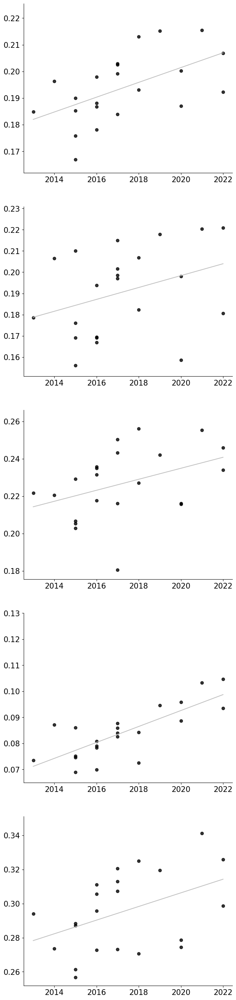

In [36]:
fig_ex, ax_ex = plt.subplots(5, 1, figsize=(7.5, 35.5))

pos = phl_ndvi_params.sort_values(["Sig Slope"])[-5:].index #, ascending=False
# fig_ex.set_title("Extreme Neighborhoods")
 
for i in range(5):
    sns.regplot(ax=ax_ex[i], x=years, y=np.array(block_group_ndvi_mean.iloc[pos[i],:]), 
                color="black", line_kws=dict(color="silver", lw=1.5), ci=None)
    # darkgreen dots / black line
    if i==3:
        ax_ex[i].set_ylim(0.065, 0.13)
    else:
        ax_ex[i].set_ylim(min(block_group_ndvi_mean.iloc[pos[i],:]) - 0.005,
                         max(block_group_ndvi_mean.iloc[pos[i],:]) + 0.01)
    ax_ex[i].tick_params(axis="both", which="major", labelsize=15) 

sns.despine()
#fig_ex.savefig("Graphs/phl_extreme_ndvi_pos.pdf")

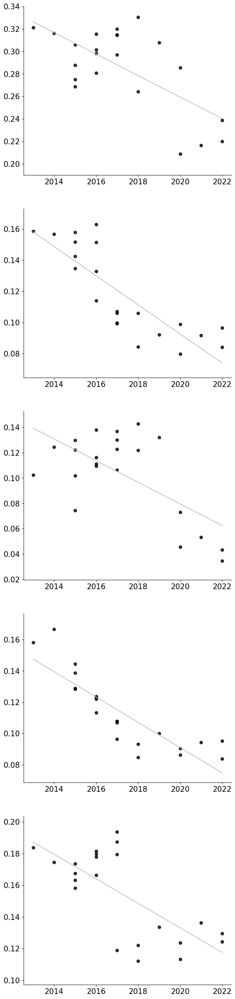

In [37]:
fig_ex, ax_ex = plt.subplots(5, 1, figsize=(7.5, 35.5))
neg = phl_ndvi_params.sort_values(["Sig Slope"])[0:5].index
for i in range(5):
    sns.regplot(ax=ax_ex[i], x=years, y=np.array(block_group_ndvi_mean.iloc[neg[i],:]), 
                color="black", line_kws=dict(color="silver", lw=1.5), ci=None)
    if i==0:
        ax_ex[i].set_ylim(0.19, 0.34)
    else:
        ax_ex[i].set_ylim(min(block_group_ndvi_mean.iloc[neg[i],:]) - 0.015,
                         max(block_group_ndvi_mean.iloc[neg[i],:]) + 0.01)
    ax_ex[i].tick_params(axis="both", which="major", labelsize=15) 
sns.despine()
#fig_ex.savefig("Graphs/phl_extreme_ndvi_neg.pdf")

# Temperature

## Generation

In [259]:
for i in range(len(dates)): 
    band_10 = f"Data/Landsat/B10/LC08_L1TP_014032_{dates[i]}_02_T1_B10.TIF"
    ndvi = f"Images/NDVI/ndvi_{access_dates[i]}.TIF"
    
    temp_file = f"Images/Temp/phl_b10_temp_{access_dates[i]}"
    temp_tif(band_10, ndvi, temp_file, boundary=city_limits)

In [37]:
phl_temp_files = [f"Images/Temp/phl_b10_temp_{day}.tif" for day in access_dates]

In [38]:
phl_census_temp = gpd.GeoDataFrame(phl_block_groups)
for i in range(len(phl_temp_files)):
    temp_stats = zonal_stats(phl_block_groups, phl_temp_files[i], stats=["mean"])
    phl_census_temp[f"mean_{access_dates[i]}"] = [s["mean"] for s in temp_stats]

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\rasterstats\io.py:328: NodataWarning: Setting nodata to -999; specify nodata explicitly
  warnings.warn(


In [42]:
phl_census_temp.head()

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,geometry,mean_20130601,mean_20130719,mean_20130820,mean_20140706,mean_20140807,mean_20150522,mean_20150607,mean_20150725,mean_20150826,mean_20160609,mean_20160625,mean_20160727,mean_20160812,mean_20160828,mean_20170612,mean_20170628,mean_20170730,mean_20170831,mean_20180615,mean_20180903,mean_20190704,mean_20190720,mean_20190922,mean_20200706,mean_20200722,mean_20200908,mean_20210623,mean_20210826,mean_20210927,mean_20220712,mean_20220813,mean_20220914
0,1,42,101,010800,1,421010108001,Block Group 1,G5030,S,161887,0,+39.9687580,-075.1997251,1.742508e+06,8200.327170,"POLYGON ((483047.282 4424385.239, 483138.583 4...",95.210426,69.595152,89.581383,84.279844,89.088114,85.193065,78.668917,99.567495,90.380975,83.825185,96.366356,91.878246,83.202287,93.136360,101.555163,92.167187,89.984557,82.814145,93.205632,83.848087,74.488343,88.438401,79.486546,79.536849,81.997605,86.551336,87.311003,79.143665,79.079705,86.978481,95.601410,83.848371
1,2,42,101,010800,2,421010108002,Block Group 2,G5030,S,103778,0,+39.9665475,-075.2004455,1.117026e+06,4364.980144,"POLYGON ((483104.517 4423969.564, 482913.923 4...",93.920320,70.258374,88.825913,85.784454,88.117789,84.975146,78.256867,97.802866,89.081683,83.571312,95.246112,91.473148,82.891656,91.853403,99.293205,91.891114,89.918521,82.787499,92.385664,83.245837,80.550134,87.989406,78.855716,78.333847,81.688208,85.854126,87.877892,72.563248,78.453979,86.231849,94.591788,83.854908
2,3,42,101,010900,2,421010109002,Block Group 2,G5030,S,43724,0,+39.9642929,-075.1896435,4.706347e+05,3048.109084,"POLYGON ((483973.375 4423833.388, 483982.128 4...",97.944848,67.784992,91.986358,88.146023,90.611274,87.452778,80.418527,101.483680,90.881913,86.204318,98.634412,94.926512,82.394888,94.654435,103.428942,95.205059,92.953821,84.558710,94.208206,83.799453,87.611478,90.730780,82.548938,94.511122,78.393214,87.796256,90.914934,85.498677,79.898430,87.740866,96.458009,86.000874
3,4,42,101,011000,2,421010110002,Block Group 2,G5030,S,108966,0,+39.9753585,-075.2113476,1.172871e+06,5169.004282,"POLYGON ((482081.555 4424838.514, 481878.506 4...",94.108957,86.943220,89.634698,81.813828,88.859955,83.595904,78.824613,98.932662,88.893847,82.769474,94.911876,91.861503,83.515724,92.291425,100.204554,91.733109,89.611918,81.980202,92.352226,84.192079,80.528396,88.715908,78.564375,88.201325,81.291612,85.948938,88.623079,78.896062,78.505645,86.603323,94.052192,83.946766
4,5,42,101,011000,1,421010110001,Block Group 1,G5030,S,142244,0,+39.9724202,-075.2051689,1.531076e+06,10476.574129,"POLYGON ((483045.331 4424813.111, 483045.608 4...",94.693510,83.177288,89.653726,82.087924,88.657364,84.474114,78.487300,98.955226,89.412096,82.689085,95.433210,91.418010,82.903920,92.025280,100.612817,91.363230,89.893161,81.948559,92.212385,83.155176,66.123744,88.019901,76.187343,88.359975,79.784234,85.650971,86.472390,75.672333,78.270696,85.855698,94.286585,83.323508


In [140]:
np.mean(phl_census_temp["mean_20170612"])

99.38250765942252

In [41]:
phl_census_temp.to_csv("Data/phl_b10_temp_block_groups_mean.csv", index=False)
phl_census_temp.to_file("Data/phl_b10_temp_block_groups_mean.geojson", driver="GeoJSON")

## Data

In [217]:
phl_temp_img = []
for i in access_dates:
    phl_temp_rio = rio.open("Images/Temp/phl_b10_temp_" + i + ".tif")
    phl_temp_img.append(phl_temp_rio)

In [258]:
for i in phl_temp_img:
    i.close()

In [ ]:
index = 8
temp_fig, temp_ax = geo_plot(phl_temp_img[index], city_limits, "Temperature on " + access_dates[index], "inferno")

In [53]:
# 1, 3, 20, 23, 27
# 12, 14, 17, 22, 24, 26

### Geojson

In [411]:
phl_temp_stats_geo = gpd.read_file("Data/phl_b10_temp_block_groups_mean.geojson")

In [413]:
alt.Chart(phl_temp_stats_geo.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["mean_20140807:Q",
                                                                                        "OBJECTID:N"],
                                                                color=alt.Color("mean_20140807:Q", 
                                                                                scale=alt.Scale(scheme="inferno")),
                                                               ).properties(width=500, height=500)

alt.Chart(...)

## Analysis
### City-Wide

In [32]:
phl_temp_stats_csv = pd.read_csv("Data/phl_b10_temp_block_groups_mean.csv")

In [18]:
phl_temp_mean = []
for i in access_dates:
    phl_temp_mean.append(np.mean(phl_temp_stats_csv["mean_"+i]))

<Axes: >

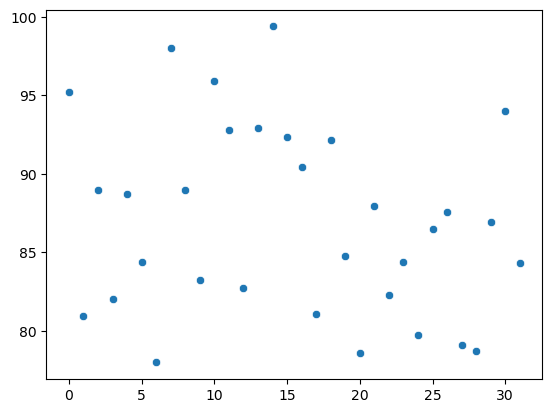

In [83]:
sns.scatterplot(data=phl_temp_mean)

In [85]:
phl_temp_mean = []
city_temp_mean = []
for i in data_dates:
    phl_temp_mean.append(np.mean(phl_temp_stats_csv["mean_"+i]))
    city = zonal_stats(city_limits, f"Images/Temp/phl_b10_temp_{i}.tif", stats=["mean"])
    city_temp_mean.append(city[0]["mean"])

In [86]:
yearly_ndvi.insert(2,"Mean Temp", city_temp_mean)

In [163]:
np.mean(yearly_ndvi["Mean Temp"])

86.12644223873612

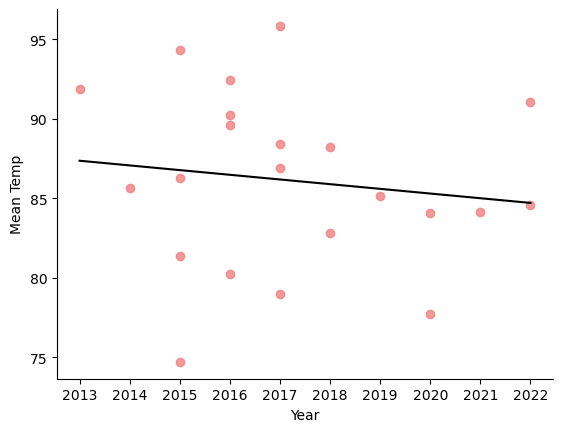

In [334]:
city_temp = sns.regplot(data=yearly_ndvi, x ="Year", y = "Mean Temp", color="lightcoral", 
                        line_kws=dict(color="black", lw=1.5), ci=None,)
city_temp.set_xticks(range(min(yearly_ndvi["Year"]), max(yearly_ndvi["Year"]) + 1))
city_temp.set_ylabel("Mean Temp")
sns.despine()
# plt.savefig("Graphs/phl_city_temp_mean.pdf")

In [162]:
temp_model = sm.OLS(yearly_ndvi["Mean Temp"].values.reshape(-1, 1), 
                    sm.add_constant([[i-2013] for i in yearly_ndvi["Year"]]))
temp_results = temp_model.fit()
print(temp_results.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.018
Model:                            OLS   Adj. R-squared:                 -0.031
Method:                 Least Squares   F-statistic:                    0.3755
Date:                Sat, 11 May 2024   Prob (F-statistic):              0.547
Time:                        15:11:08   Log-Likelihood:                -67.931
No. Observations:                  22   AIC:                             139.9
Df Residuals:                      20   BIC:                             142.0
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         87.3723      2.354     37.116      0.0

In [33]:
block_group_temp_mean = phl_temp_stats_csv.loc[:, [f"mean_{day}" for day in data_dates]]

In [69]:
y_temp = block_group_temp_mean.T.melt(value_vars = range(len(phl_block_groups)))
x_time_ndvi = np.append(x_time, pd.DataFrame(y_ndvi.value), axis=1)

In [322]:
x_time_ndvi.shape

(29392, 2673)

In [323]:
time_ndvi_temp_ols = sm.OLS(y_temp["value"].values.reshape(-1, 1), x_time_ndvi)
time_ndvi_temp_ols_results = time_ndvi_temp_ols.fit()

In [325]:
time_ndvi_temp_ols_results.params

array([79.38371682, 74.06901406, 85.38420785, ..., -0.17337357,
       -0.44698761, 70.63286156])

In [327]:
rmse_fixed = np.sqrt(np.mean(np.square(time_ndvi_temp_ols_results.resid)))
rmse_fixed

5.8390255092866115

In [379]:
np.sum(time_ndvi_temp_ols_results.tvalues[1336:2632]>0)
#np.mean(phl_temp_params["Time Slope"] )

63

<Axes: xlabel='value', ylabel='value'>

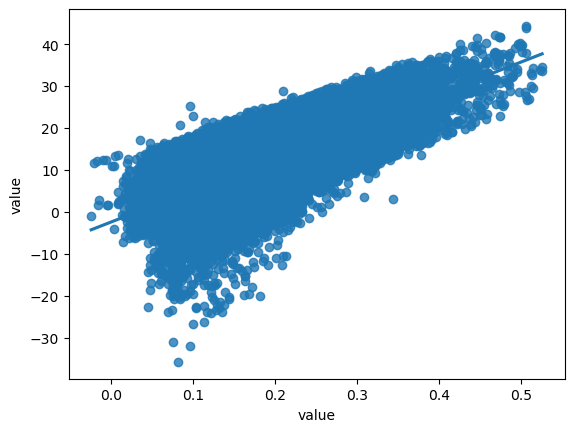

In [346]:
sns.regplot(x=y_ndvi["value"], y=(y_temp["value"] - np.repeat(time_ndvi_temp_ols_results.params[:1336], len(data_dates))
                                 - ))

In [345]:
#phl_temp_params.to_csv("Data/phl_temp_OLS.csv", index=False)
#phl_temp_params.to_file("Data/phl_temp_OLS.geojson", driver="GeoJSON")

In [60]:
phl_temp_params = gpd.read_file("Data/phl_temp_OLS.geojson")

<Axes: xlabel='RE Intercept', ylabel='RE Time'>

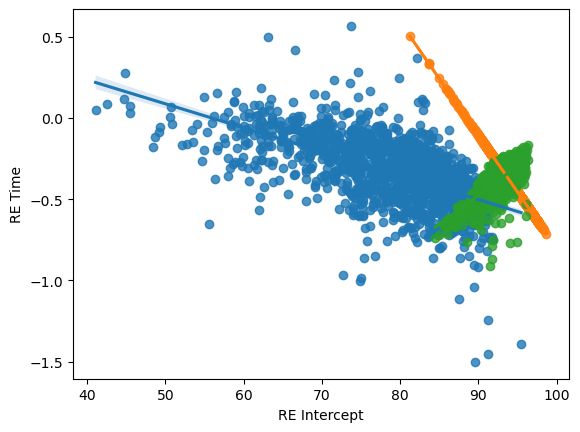

In [362]:
sns.regplot(x=time_ndvi_temp_ols_results.params[:1336], y=time_ndvi_temp_ols_results.params[1336:2672])
sns.regplot(x=city_means["RE Intercept"], y=city_means["RE Time"])
sns.regplot(x=[(temp_re.params["Intercept"] + temp_re.random_effects[i].iloc[0]) for i in range(1336)],
            y=[(temp_re.params["Time"] + temp_re.random_effects[i].iloc[1]) for i in range(1336)])

Temp vs NDVI

In [48]:
x_ndvi = np.zeros((len(data_dates)*len(phl_block_groups), len(phl_block_groups)+1))
for i in range(len(phl_block_groups)):
    a = i*len(data_dates)
    b = (i+1)*len(data_dates)
    x_ndvi[a:b, i] = np.ones(len(data_dates))
    #x_ndvi[a:b, i+len(phl_block_groups)] = block_group_ndvi_mean.iloc[i]
x_ndvi[:,-1] = y_ndvi["value"]
x_ndvi

array([[1.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.16673635],
       [1.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.17925576],
       [1.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.16068718],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 1.        ,
        0.16076771],
       [0.        , 0.        , 0.        , ..., 0.        , 1.        ,
        0.17707193],
       [0.        , 0.        , 0.        , ..., 0.        , 1.        ,
        0.16486107]])

In [378]:
ndvi_temp_ols = sm.OLS(y_temp["value"].values.reshape(-1, 1), x_ndvi)
ndvi_temp_ols_results = ndvi_temp_ols.fit()
ndvi_temp_ols_results.params

array([77.58174044, 72.74564473, 82.6937485 , ..., 78.93835674,
       78.56027465, 71.121531  ])

In [107]:
np.sum(ndvi_temp_ols_results.tvalues > 1.96)

1337

In [ ]:
resid = y_temp["value"] - np.repeat(np.array(city_means["RE Intercept"]), len(data_dates))
resid = resid - np.repeat(np.array(city_means["RE Time"]), len(data_dates)) * temp_time_ndvi["Time"]
sns.regplot(x=y_ndvi["value"], y=resid)

In [195]:
phl_temp_params["NDVI Intercept"] = ndvi_temp_ols_results.params[0:1336]
phl_temp_params["NDVI Slope"] = ndvi_temp_ols_results.params[1336:]
phl_temp_params["Sig NDVI Slope"] = np.multiply(np.abs(ndvi_temp_ols_results.tvalues[1336:]) > 1.96, 
                                           phl_temp_params["NDVI Slope"])

In [61]:
phl_temp_params.head()

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,Intercept,Time Slope,Sig Time Slope,NDVI,geometry
0,1,42,101,010800,1,421010108001,Block Group 1,G5030,S,161887,0,+39.9687580,-075.1997251,1.742508e+06,8200.327170,79.383717,-0.406550,-0.0,70.632862,"POLYGON ((483047.282 4424385.239, 483138.583 4..."
1,2,42,101,010800,2,421010108002,Block Group 2,G5030,S,103778,0,+39.9665475,-075.2004455,1.117026e+06,4364.980144,74.069014,-0.286632,-0.0,70.632862,"POLYGON ((483104.517 4423969.564, 482913.923 4..."
2,3,42,101,010900,2,421010109002,Block Group 2,G5030,S,43724,0,+39.9642929,-075.1896435,4.706347e+05,3048.109084,85.384208,-0.622405,-0.0,70.632862,"POLYGON ((483973.375 4423833.388, 483982.128 4..."
3,4,42,101,011000,2,421010110002,Block Group 2,G5030,S,108966,0,+39.9753585,-075.2113476,1.172871e+06,5169.004282,78.249081,-0.194977,-0.0,70.632862,"POLYGON ((482081.555 4424838.514, 481878.506 4..."
4,5,42,101,011000,1,421010110001,Block Group 1,G5030,S,142244,0,+39.9724202,-075.2051689,1.531076e+06,10476.574129,75.245100,-0.515995,-0.0,70.632862,"POLYGON ((483045.331 4424813.111, 483045.608 4..."


0       -0.000000
1       -0.344821
2       -0.689642
3       -0.689642
4       -0.689642
           ...   
29387   -2.603546
29388   -2.603546
29389   -2.975481
29390   -3.347416
29391   -3.347416
Name: Time, Length: 29392, dtype: float64

#### Random Effects

In [70]:
obj_id = y_temp["variable"] #np.repeat(phl_block_groups["OBJECTID"], len(data_dates))
temp_time_ndvi = pd.DataFrame({"Temp": y_temp["value"], 
                             "Intercepts": np.ones(1336*len(data_dates)),
                             "Time": np.tile(np.array(years)-2013, 1336),
                             "NDVI": y_ndvi["value"]})

In [ ]:
temp_data = pd.DataFrame(x_ndvi)
temp_data["Temp"] = y_temp["value"]
temp_data["Time"] = np.tile(np.array(years)-2013, 1336)
# temp_data = pd.DataFrame(np.append(pd.DataFrame(y_temp["value"]), time_ndvi, axis=1))
# pd.DataFrame(np.append(pd.DataFrame(y_temp["value"]), x_time_ndvi, axis=1))

In [387]:
intercept_a = [("a"+str(i)) for i in range(1,1337)]
slope_b = [("b"+str(i)) for i in range(1,1337)]
temp_data.columns = intercept_a + ["NDVI", "Temp", "Time"]

In [390]:
all_var = "-1"
formula_re = ""
for i in range(1336):
    all_var += " + " + intercept_a[i]
    formula_re += " + " + slope_b[i]
formula = "Temp ~ "+all_var+"+ NDVI + Time"
formula_re = "0" + formula_re

In [71]:
temp_re = smf.mixedlm(formula, groups=obj_id, data=temp_data, re_formula = "0+Time").fit() 
# Intercepts Only: "Temp ~ Intercepts-1" w/ 0+Intercepts
# smf.mixedlm(formula, groups=obj_id[0:23], data=temp_data.iloc[0:23,:], re_formula = formula_re).fit()
#print(temp_re.summary())

NameError: name 'formula' is not defined

##### Mixed Model

In [74]:
temp_re = smf.mixedlm("Temp ~ Time + NDVI", groups=obj_id, data=temp_time_ndvi, re_formula = "1",
                      vc_formula = {"Time": '0 + Time'}).fit() #
print(temp_re.summary())

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\statsm

          Mixed Linear Model Regression Results
Model:            MixedLM Dependent Variable: Temp       
No. Observations: 29392   Method:             REML       
No. Groups:       1336    Scale:              36.4281    
Min. group size:  22      Log-Likelihood:     -96313.6820
Max. group size:  22      Converged:          No         
Mean group size:  22.0                                   
---------------------------------------------------------
             Coef.  Std.Err.    z     P>|z| [0.025 0.975]
---------------------------------------------------------
Intercept    92.716    0.062 1500.638 0.000 92.595 92.838
Time         -0.377    0.019  -19.412 0.000 -0.415 -0.339
NDVI        -11.263                                      
Group Var     8.761                                      
Time Var      0.231                                      



In [75]:
temp_re_corr = smf.mixedlm("Temp ~ Time + NDVI", groups=obj_id, data=temp_time_ndvi, re_formula = "1 + Time").fit() 
print(temp_re_corr.summary())

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\statsmodels\regression\mixed_linear_model.py:2262: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)


             Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Temp       
No. Observations:   29392     Method:               REML       
No. Groups:         1336      Scale:                37.0576    
Min. group size:    22        Log-Likelihood:       -95745.7887
Max. group size:    22        Converged:            Yes        
Mean group size:    22.0                                       
---------------------------------------------------------------
                  Coef.  Std.Err.    z    P>|z|  [0.025  0.975]
---------------------------------------------------------------
Intercept         93.917    0.224 419.639 0.000  93.478  94.355
Time              -0.381    0.016 -24.316 0.000  -0.412  -0.350
NDVI             -17.956    1.082 -16.597 0.000 -20.077 -15.836
Group Var         10.006                                       
Group x Time Cov  -0.705                                       
Time Var           0.050                             

In [276]:
93.917 + temp_re_corr.random_effects[0]["Group"] + 3*(temp_re_corr.random_effects[0].iloc[1] -0.377) -17.956 * 0.171746
#- temp_re_corr.random_effects[0]["Group"]
# 89.134 #89.71673384, 89.00244344
# Correletation: -0.705/np.sqrt(10*.05)
#np.corrcoef(temp_time_ndvi["Temp"], temp_time_ndvi["Time"])
np.sum(temp_re_corr.resid - temp_re.resid)

2.5479494070168585e-09

In [263]:
np.mean([temp_re_corr.random_effects[i].iloc[1] for i in range(1336)])

9.59837665103925e-14

In [372]:
rmse_re = np.sqrt(np.mean(np.square(temp_re.resid)))
rmse_re

5.979433907671704

In [371]:
temp_re.params

Intercept    92.716448
Time         -0.376757
NDVI        -11.262619
Group Var     0.240514
Time Var      0.006348
dtype: float64

Correlated (temp_re_corr) or Not (temp_re)

In [76]:
city_means["RE Intercept"] = [(temp_re.params["Intercept"] + temp_re.random_effects[i].iloc[0]) 
                              for i in range(1336)]
city_means["RE Time"] = [(temp_re.params["Time"] + temp_re.random_effects[i].iloc[1]) for i in range(1336)]
city_means["FE NDVI"] = np.ones(1336)*temp_re.params["NDVI"]
city_means

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,geometry,Temperature,NDVI,RE Intercept,RE Time,FE NDVI
0,1,42,101,010800,1,421010108001,Block Group 1,G5030,S,161887,0,+39.9687580,-075.1997251,1.742508e+06,8200.327170,"POLYGON ((483047.282 4424385.239, 483138.583 4...",89.716734,0.170623,93.035715,-0.344821,-11.262619
1,2,42,101,010800,2,421010108002,Block Group 2,G5030,S,103778,0,+39.9665475,-075.2004455,1.117026e+06,4364.980144,"POLYGON ((483104.517 4423969.564, 482913.923 4...",89.002443,0.228578,92.899519,-0.321079,-11.262619
2,3,42,101,010900,2,421010109002,Block Group 2,G5030,S,43724,0,+39.9642929,-075.1896435,4.706347e+05,3048.109084,"POLYGON ((483973.375 4423833.388, 483982.128 4...",91.336407,0.121520,94.015844,-0.368176,-11.262619
3,4,42,101,011000,2,421010110002,Block Group 2,G5030,S,108966,0,+39.9753585,-075.2113476,1.172871e+06,5169.004282,"POLYGON ((482081.555 4424838.514, 481878.506 4...",89.107243,0.165396,92.497265,-0.351481,-11.262619
4,5,42,101,011000,1,421010110001,Block Group 1,G5030,S,142244,0,+39.9724202,-075.2051689,1.531076e+06,10476.574129,"POLYGON ((483045.331 4424813.111, 483045.608 4...",88.886377,0.224011,92.985128,-0.384782,-11.262619
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1331,1332,42,101,016200,2,421010162002,Block Group 2,G5030,S,223441,0,+39.9843381,-075.1407049,2.405057e+06,6772.642577,"POLYGON ((487748.279 4426244.635, 487804.613 4...",88.817272,0.188312,92.453065,-0.346589,-11.262619
1332,1333,42,101,015600,2,421010156002,Block Group 2,G5030,S,177448,0,+39.9806576,-075.1425322,1.909996e+06,6128.309258,"POLYGON ((487958.845 4425505.326, 487930.490 4...",89.582824,0.172601,93.013542,-0.364994,-11.262619
1333,1334,42,101,015700,3,421010157003,Block Group 3,G5030,S,305254,0,+39.9768522,-075.1353407,3.285646e+06,9381.401996,"POLYGON ((488201.019 4425463.770, 488209.982 4...",90.182136,0.119652,93.153513,-0.403661,-11.262619
1334,1335,42,101,017900,5,421010179005,Block Group 5,G5030,S,275799,0,+39.9858493,-075.1177472,2.968631e+06,9625.938356,"POLYGON ((490129.475 4425938.838, 490092.508 4...",90.868459,0.167742,93.939914,-0.334366,-11.262619


In [77]:
np.sum(city_means["RE Time"] > 0)
city_means["RE Intercept"].describe()

count    1336.000000
mean       92.716448
std         1.792307
min        84.485399
25%        91.792658
50%        92.836241
75%        93.947325
max        96.299750
Name: RE Intercept, dtype: float64

### Spatial

In [62]:
neigh_temp = np.mean(block_group_temp_mean, axis=1)
neigh_ndvi = np.mean(block_group_ndvi_mean, axis=1)

In [63]:
city_means = gpd.GeoDataFrame(phl_block_groups)
city_means["Temperature"] = neigh_temp
city_means["NDVI"] = neigh_ndvi

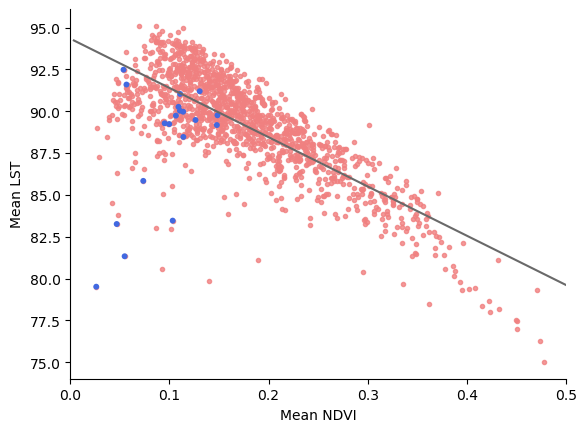

In [306]:
city_plot = sns.regplot(x=neigh_ndvi, y=neigh_temp, color="lightcoral",
                        line_kws=dict(color="dimgray", lw=1.5), 
                        truncate = False, ci=None, marker=".") #scatter_kws=dict(alpha=.75)
sns.scatterplot(data=city_means.loc[city_means["GWR Slope"]>0,], x="NDVI", y="Temperature",
               color = "royalblue", linewidth=0, size=0.7, legend=False) 
city_plot.set_xticks([i/10 for i in range(0,6)])

city_plot.set_xlabel("Mean NDVI")
city_plot.set_ylabel("Mean LST")
sns.despine()
# plt.savefig("Graphs/phl_temp_NDVI_mean.pdf")

In [176]:
alt.Chart(city_means).mark_point().encode(
    x='NDVI:Q',
    y=alt.Y('Temperature:Q').scale(domain=(70, 100)),
    tooltip=['OBJECTID:N', "GWR Slope:Q"],
    color="GWR Slope:Q"
)

alt.Chart(...)

##### Water

In [171]:
del_river = [i-1 for i in [53, 211, 124, 1326, 469, 468, 467, 622, 136, 771, 774, 762, 764]]
no_water = pd.DataFrame(city_means).drop(index=del_river)
no_water.shape

(1323, 19)

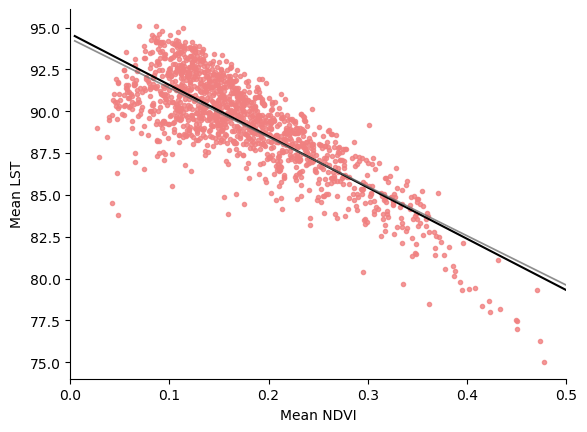

In [199]:
city_plot = sns.regplot(data=no_water, x="NDVI", y="Temperature", color="lightcoral",
                        line_kws=dict(color="black", lw=1.5), 
                        truncate = False, ci=None, marker=".") #scatter_kws=dict(alpha=.75)
sns.regplot(x=neigh_ndvi, y=neigh_temp, line_kws=dict(color="dimgray", lw=1.25, alpha=0.75), 
                        truncate = False, ci=None, scatter=False)

city_plot.set_xticks([i/10 for i in range(0,6)])

city_plot.set_xlabel("Mean NDVI")
city_plot.set_ylabel("Mean LST")
sns.despine()
# plt.savefig("Graphs/phl_temp_NDVI_mean_no_water.pdf")

In [177]:
ndvi_temp_model = sm.OLS(neigh_temp, sm.add_constant(neigh_ndvi))
ndvi_temp_results = ndvi_temp_model.fit()
print(ndvi_temp_results.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.589
Model:                            OLS   Adj. R-squared:                  0.588
Method:                 Least Squares   F-statistic:                     1910.
Date:                Sat, 11 May 2024   Prob (F-statistic):          1.22e-259
Time:                        15:33:00   Log-Likelihood:                -2785.1
No. Observations:                1336   AIC:                             5574.
Df Residuals:                    1334   BIC:                             5585.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         94.3362      0.130    723.305      0.0

In [178]:
ndvi_temp_model = sm.OLS(no_water.Temperature, sm.add_constant(no_water.NDVI))
ndvi_temp_results = ndvi_temp_model.fit()
print(ndvi_temp_results.summary())

                            OLS Regression Results                            
Dep. Variable:            Temperature   R-squared:                       0.660
Model:                            OLS   Adj. R-squared:                  0.659
Method:                 Least Squares   F-statistic:                     2560.
Date:                Sat, 11 May 2024   Prob (F-statistic):          2.11e-311
Time:                        15:33:32   Log-Likelihood:                -2607.2
No. Observations:                1323   AIC:                             5218.
Df Residuals:                    1321   BIC:                             5229.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         94.6309      0.118    804.909      0.0

In [183]:
spatial_ols = spreg.OLS(y=neigh_temp.values.reshape(-1, 1), x=neigh_ndvi.values.reshape(-1, 1), w=phl_weights,
                       spat_diag=True, moran=True, name_y="Temp", name_x = ["NDVI"])
print(spatial_ols.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :        Temp                Number of Observations:        1336
Mean dependent var  :     89.1341                Number of Variables   :           2
S.D. dependent var  :      3.0353                Degrees of Freedom    :        1334
R-squared           :      0.5887
Adjusted R-squared  :      0.5884
Sum squared residual:     5058.66                F-statistic           :   1909.5067
Sigma-square        :       3.792                Prob(F-statistic)     :  1.219e-259
S.E. of regression  :       1.947                Log likelihood        :   -2785.092
Sigma-square ML     :       3.786                Akaike info criterion :    5574.184
S.E of regression ML:      1.9459                Schwarz criterion     :    5584.579

------------------------------------------------------------

In [184]:
rmse_ols = np.sqrt(np.mean(np.square(spatial_ols.u)))
rmse_ols

1.9458737634726309

In [185]:
no_water_weights = weights.Queen.from_dataframe(gpd.GeoDataFrame(no_water), ids = "OBJECTID")
no_water_weights.transform = "r"
spatial_ols_water = spreg.OLS(y=no_water["Temperature"].values.reshape(-1, 1), x=no_water["NDVI"].values.reshape(-1, 1),
                              w=no_water_weights, spat_diag=True, moran=True, name_y="Temp", name_x = ["NDVI"])
print(spatial_ols_water.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ORDINARY LEAST SQUARES
-----------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :        Temp                Number of Observations:        1323
Mean dependent var  :     89.1961                Number of Variables   :           2
S.D. dependent var  :      2.9770                Degrees of Freedom    :        1321
R-squared           :      0.6596
Adjusted R-squared  :      0.6593
Sum squared residual:     3988.35                F-statistic           :   2559.5457
Sigma-square        :       3.019                Prob(F-statistic)     :   2.11e-311
S.E. of regression  :       1.738                Log likelihood        :   -2607.205
Sigma-square ML     :       3.015                Akaike info criterion :    5218.410
S.E of regression ML:      1.7363                Schwarz criterion     :    5228.785

------------------------------------------------------------

In [186]:
rmse_ols_water = np.sqrt(np.mean(np.square(spatial_ols_water.u)))
rmse_ols_water

1.7362678576579695

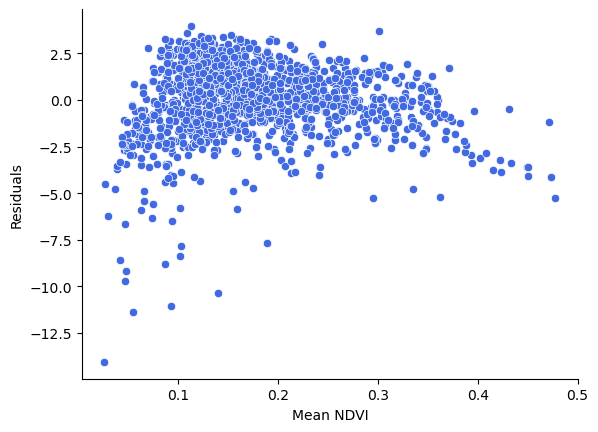

In [185]:
resid = sns.scatterplot(x=neigh_ndvi, y=spatial_ols.u[:,0], color="royalblue")
resid.set_xlabel("Mean NDVI")
resid.set_ylabel("Residuals")
sns.despine()

In [35]:
spatial_error = spreg.ML_Error(y=neigh_temp.values.reshape(-1, 1), x=neigh_ndvi.values.reshape(-1, 1), w=phl_weights,
                               name_y="Temp", name_x = ["NDVI"], slx_lags=1) 
print(spatial_error.summary)

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\scipy\optimize\_minimize.py:913: RuntimeWarning: Method 'bounded' does not support relative tolerance in x; defaulting to absolute tolerance.
  warn("Method 'bounded' does not support relative tolerance in x; "


REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ML SPATIAL ERROR WITH SLX (SDEM) (METHOD = full)
-------------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :        Temp                Number of Observations:        1336
Mean dependent var  :     89.1341                Number of Variables   :           3
S.D. dependent var  :      3.0353                Degrees of Freedom    :        1333
Pseudo R-squared    :      0.5887
Log likelihood      :  -2162.1221
Sigma-square ML     :      1.2479                Akaike info criterion :    4330.244
S.E of regression   :      1.1171                Schwarz criterion     :    4345.837

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
        

In [27]:
rmse_error = np.sqrt(np.mean(np.square(spatial_error.u)))
rmse_error

1.9696265790716665

In [19]:
city_ndvi_lag = weights.lag_spatial(phl_weights, neigh_ndvi)
#weight_error = weights.lag_spatial(phl_weights, spreg.OLS(y=neigh_temp.values.reshape(-1, 1), x=a).u)

In [23]:
print(spatial_error.predy[1])
np.dot(spatial_error.betas.T, np.array([[1], [neigh_ndvi[1]], [city_ndvi_lag[1]], [weight_error[1][0]]]))

[87.87047873]


NameError: name 'weight_error' is not defined

In [20]:
a = np.append(neigh_ndvi.values.reshape(-1, 1), city_ndvi_lag.reshape(-1, 1), axis=1)
spatial_error = spreg.ML_Error(y=neigh_temp.values.reshape(-1, 1), x=a, w=phl_weights,
                               name_y="Temp", name_x = ["NDVI", "Weighted"])
print(spatial_error.summary)

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\scipy\optimize\_minimize.py:913: RuntimeWarning: Method 'bounded' does not support relative tolerance in x; defaulting to absolute tolerance.
  warn("Method 'bounded' does not support relative tolerance in x; "


REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: ML SPATIAL ERROR (METHOD = full)
---------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :        Temp                Number of Observations:        1336
Mean dependent var  :     89.1341                Number of Variables   :           3
S.D. dependent var  :      3.0353                Degrees of Freedom    :        1333
Pseudo R-squared    :      0.5887
Log likelihood      :  -2162.1221
Sigma-square ML     :      1.2479                Akaike info criterion :    4330.244
S.E of regression   :      1.1171                Schwarz criterion     :    4345.837

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT        95.12736    

In [119]:
np.array(ndvi_lag.value)

array([0.22346268, 0.22494161, 0.22987968, ..., 0.09564295, 0.12939504,
       0.11556827])

In [181]:
spatial_lag = spreg.ML_Lag(y=neigh_temp.values.reshape(-1, 1), x=neigh_ndvi.values.reshape(-1, 1), w=phl_weights,
                             name_y="Temp", name_x = ["NDVI"], slx_lags=1)
print(spatial_lag.summary)

REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: MAXIMUM LIKELIHOOD SPATIAL LAG WITH SLX - SPATIAL DURBIN MODEL (METHOD = FULL)
-------------------------------------------------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :        Temp                Number of Observations:        1336
Mean dependent var  :     89.1341                Number of Variables   :           4
S.D. dependent var  :      3.0353                Degrees of Freedom    :        1332
Pseudo R-squared    :      0.8655
Spatial Pseudo R-squared:  0.5843
Log likelihood      :  -2164.9561
Sigma-square ML     :      1.2535                Akaike info criterion :    4337.912
S.E of regression   :      1.1196                Schwarz criterion     :    4358.702

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability

In [80]:
rmse_lag = np.sqrt(np.mean(np.square(spatial_lag.u)))
rmse_lag

1.115762431802995

##### GWR

In [32]:
from mgwr import gwr, sel_bw

In [33]:
coord = list(zip(phl_block_groups.centroid.x, phl_block_groups.centroid.y))
band = sel_bw.Sel_BW(coord, neigh_temp.values.reshape(-1, 1), neigh_ndvi.values.reshape(-1, 1)).search()
print(band)

46.0


In [34]:
gwr_model = gwr.GWR(coord, neigh_temp.values.reshape(-1, 1), neigh_ndvi.values.reshape(-1, 1), band).fit()
gwr_model.summary()
#phl_weights

Model type                                                         Gaussian
Number of observations:                                                1336
Number of covariates:                                                     2

Global Regression Results
---------------------------------------------------------------------------
Residual sum of squares:                                           5058.663
Log-likelihood:                                                   -2785.092
AIC:                                                               5574.184
AICc:                                                              5576.202
BIC:                                                              -4542.715
R2:                                                                   0.589
Adj. R2:                                                              0.588

Variable                              Est.         SE  t(Est/SE)    p-value
------------------------------- ---------- ---------- ------

In [35]:
city_means["GWR Slope"] = gwr_model.params[:,1]

In [213]:
alt.Chart(city_means.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["Temperature:Q", "NDVI:Q", 
                                                                                "GWR Slope:Q", "OBJECTID:N"],
                                                                color=alt.Color("GWR Slope:Q", 
                                                                                scale=alt.Scale(domain=[-50, 50],
                                                                                                scheme="redblue")),
                                                               ).properties(width=500, height=500)

alt.Chart(...)

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


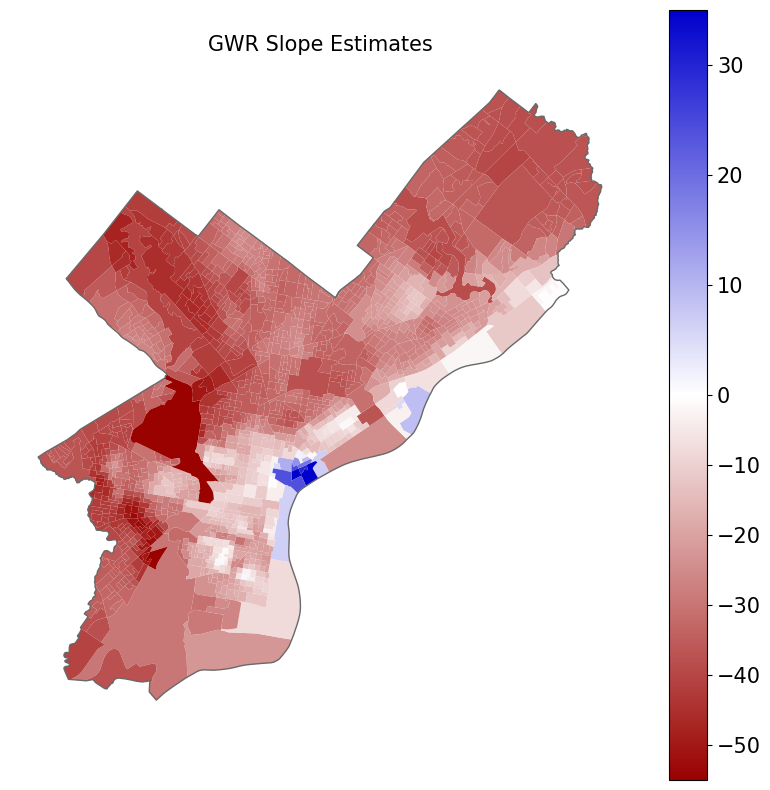

In [37]:
fig_gwr, ax_gwr = plt.subplots(figsize=(10,10))

#phl_block_groups.plot(ax=ax_gwr, edgecolor="silver", facecolor="none", linewidth=0.01)
colors = color.LinearSegmentedColormap.from_list("gwr_map", ["xkcd:deep red", "White", "mediumblue"])
city_means.plot("GWR Slope", ax = ax_gwr, cmap = colors,
                     label="GWR Slopes", legend = True, norm=color.TwoSlopeNorm(vmin=-55, vcenter=0, vmax=35)) 
ax_gwr.set_title("GWR Slope Estimates", fontsize=15)

cbar = ax_gwr.figure.axes[1] 
cbar.tick_params(labelsize=15)

city_limits.plot(ax=ax_gwr, edgecolor="dimgray", facecolor="none", linewidth=1)
ax_gwr.set_axis_off()

#fig_gwr.savefig("Graphs/phl_temp_NDVI_gwr.pdf")

##### Hotspots

In [39]:
import esda

In [232]:
city_means.sort_values(["NDVI"])[-5:]

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,geometry,Temperature,NDVI,GWR Slope
570,571,42,101,022000,1,421010220001,Block Group 1,G5030,S,2944018,99558,+40.0562177,-075.2520092,3.270159e+07,26057.880736,"POLYGON ((478252.524 4434748.833, 478259.627 4...",76.988537,0.450568,-39.563219
978,979,42,101,038400,1,421010384001,Block Group 1,G5030,S,1898398,0,+40.0732932,-075.2322576,1.745546e+07,31027.407136,"POLYGON ((480105.014 4436205.087, 480155.151 4...",77.489403,0.450718,-47.897270
289,290,42,101,980800,1,421019808001,Block Group 1,G5030,S,2106698,43823,+39.9714517,-075.2621770,2.337327e+07,41368.867499,"POLYGON ((478099.306 4425717.760, 478147.782 4...",79.302352,0.470997,-36.617171
274,275,42,101,980200,1,421019802001,Block Group 1,G5030,S,5200674,250845,+40.0714709,-075.0443910,5.801488e+07,87405.959597,"POLYGON ((495195.492 4437488.736, 495188.318 4...",76.288727,0.473579,-38.294877
211,212,42,101,980100,1,421019801001,Block Group 1,G5030,S,5476589,240667,+40.0509585,-075.2149160,6.342794e+07,99057.866150,"POLYGON ((480862.945 4436563.378, 480947.194 4...",75.017728,0.477645,-40.480316


In [40]:
local_i = esda.moran.Moran_Local(city_means["NDVI"], phl_weights)
local_temp = esda.moran.Moran_Local(city_means["Temperature"], phl_weights)

<Axes: xlabel='NDVI'>

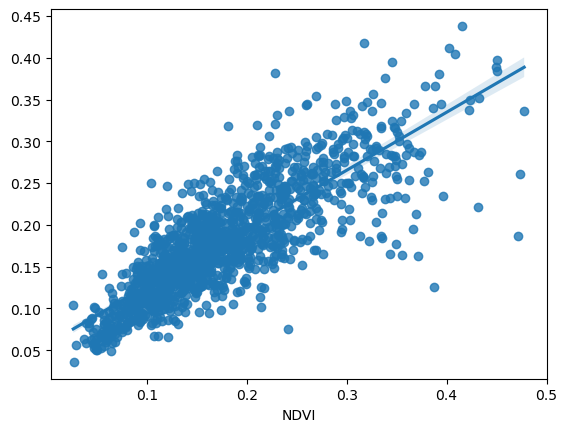

In [239]:
sns.regplot(x=city_means["NDVI"], y=city_ndvi_lag)

In [41]:
city_means["NDVI Coldspot"] = ((local_i.p_sim < 0.05) * (local_i.q==3))*3
city_means["NDVI Hotspot"] = ((local_i.p_sim < 0.05) * (local_i.q==1))*1
city_means["Temp Coldspot"] = ((local_temp.p_sim < 0.05) * (local_temp.q==3))*3
city_means["Temp Hotspot"] = ((local_temp.p_sim < 0.05) * (local_temp.q==1))*1

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


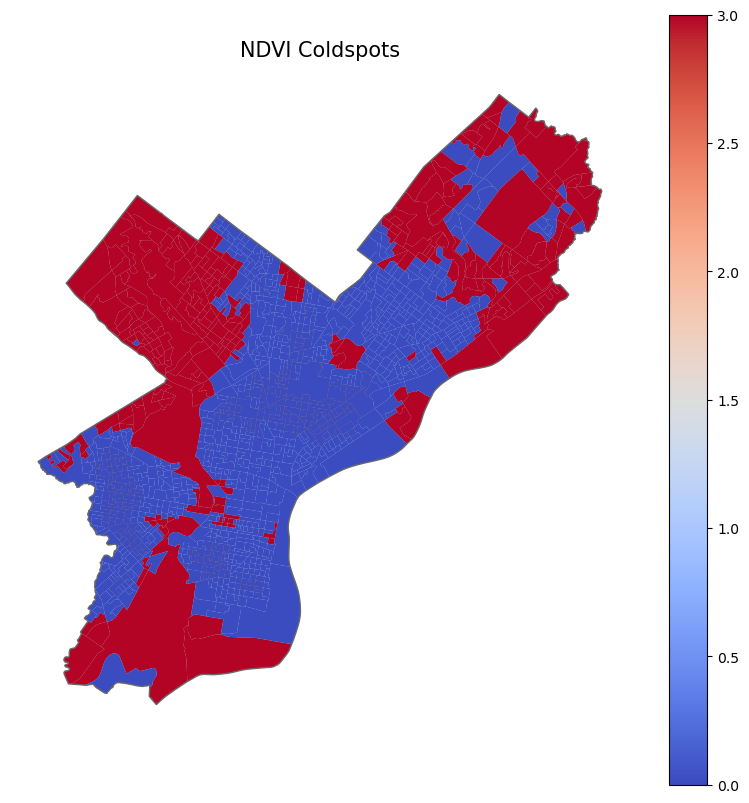

In [43]:
fig_spots, ax_spots = plt.subplots(figsize=(10,10))

#phl_block_groups.plot(ax=ax_gwr, edgecolor="silver", facecolor="none", linewidth=0.01)
colors = color.LinearSegmentedColormap.from_list("spot_map", ["White", "mediumblue"])
city_means.plot("Temp Hotspot", ax = ax_spots, cmap = "Paired",
                     label="Hotspots")
city_means.plot("Temp Coldspot", ax = ax_spots, cmap = "coolwarm",
                     label="Coldspots", legend = True) 
ax_spots.set_title("NDVI Coldspots", fontsize=15)

city_limits.plot(ax=ax_spots, edgecolor="dimgray", facecolor="none", linewidth=1)
ax_spots.set_axis_off()

#fig_spots.savefig("Graphs/phl_NDVI_hotspots.pdf")

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


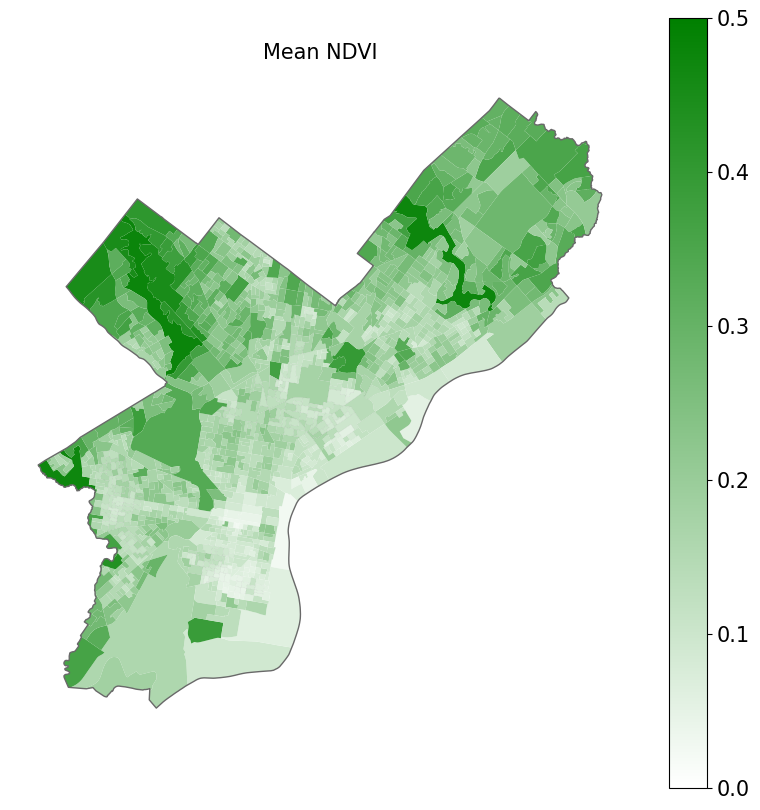

In [46]:
fig_ndvi_means, ax_ndvi_means = plt.subplots(figsize=(10,10))

colors = color.LinearSegmentedColormap.from_list("ndvi_map", ["White", "Green"])
# In temp
city_means.plot("NDVI", ax = ax_ndvi_means, cmap = colors, label="NDVI", legend = True, norm=plt.Normalize(vmin=0, vmax=0.5)) 
ax_ndvi_means.set_title("Mean NDVI", fontsize=15)

cbar = ax_ndvi_means.figure.axes[1] 
cbar.tick_params(labelsize=15)

city_limits.plot(ax=ax_ndvi_means, edgecolor="dimgray", facecolor="none", linewidth=1)
#city_means.sort_values(["NDVI"])[-10:].plot(ax=ax_ndvi_means, edgecolor="black", facecolor="none", linewidth=1)
#city_means.sort_values(["NDVI"])[0:10].plot(ax=ax_ndvi_means, edgecolor="black", facecolor="none", linewidth=1)
city_means.loc[(city_means["Temp Hotspot"] == 1),:].plot(ax = ax_ndvi_means, edgecolor="Black", facecolor="none", linewidth=0.01)
ax_ndvi_means.set_axis_off()
#fig_ndvi_means.savefig("Graphs/phl_mean_NDVI.pdf")

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


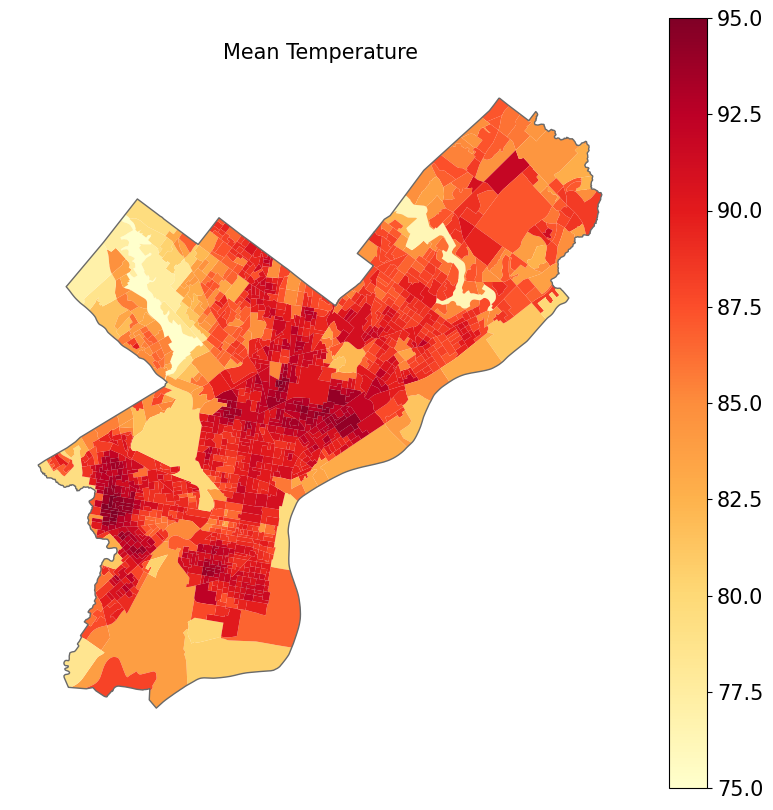

In [47]:
fig_temp_means, ax_temp_means = plt.subplots(figsize=(10,10))

city_means.plot("Temperature", ax = ax_temp_means, cmap = "YlOrRd", label="Temp", legend = True,
               norm=plt.Normalize(vmin=75, vmax=95)) 
ax_temp_means.set_title("Mean Temperature", fontsize=15)

cbar = ax_temp_means.figure.axes[1] 
cbar.tick_params(labelsize=15)

city_limits.plot(ax=ax_temp_means, edgecolor="dimgray", facecolor="none", linewidth=1)
#city_means.sort_values(["Temperature"])[0:10].plot(ax=ax_temp_means, edgecolor="black", facecolor="none", linewidth=1)
#city_means.sort_values(["NDVI"])[-20:].plot(ax=ax_temp_means, edgecolor="black", facecolor="none", linewidth=1)
city_means.loc[(city_means["Temp Hotspot"] == 1),:].plot(ax = ax_temp_means, edgecolor="black", facecolor="none", linewidth=0.01)
#city_means.loc[(city_means["NDVI Hotspot"] == 1),:].plot(ax = ax_temp_means, edgecolor="Black", facecolor="none", linewidth=1)

ax_temp_means.set_axis_off()
#fig_temp_means.savefig("Graphs/phl_mean_temp.pdf")

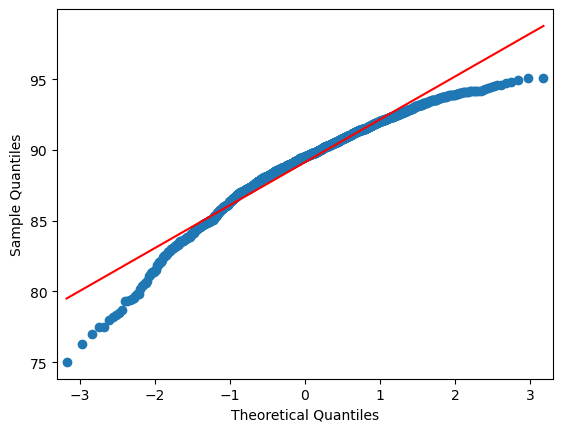

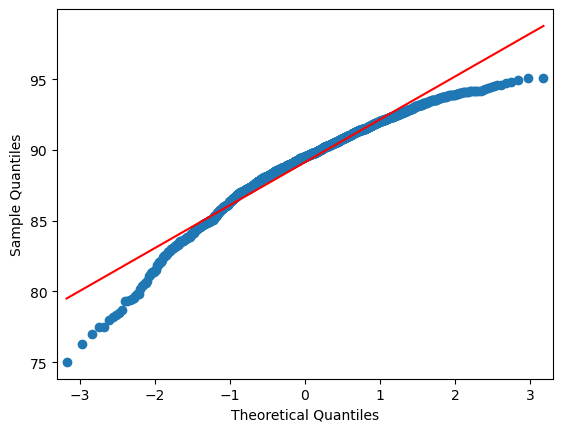

In [92]:
sm.qqplot(data=neigh_temp, line="s")

### Extreme Neighborhoods

In [63]:
fig_ex, ax_ex = plt.subplots(5, 1, figsize=(7, 35.5))

pos = phl_ndvi_params.sort_values(["Sig Slope"])[-5:].index #, ascending=False
# fig_ex.set_title("Extreme Neighborhoods")
# sns.set_style("whitegrid")
for i in range(5):
    sns.regplot(ax=ax_ex[i], x=years, y=np.array(block_group_ndvi_mean.iloc[pos[i],:]), 
                color="darkgreen", line_kws=dict(color="black", lw=1.5), ci=None)
    # Temp - block_group_temp_mean / "lightcoral"
#sns.set(font_scale = 1.5)
sns.despine()
#fig_ex.savefig("Graphs/phl_extreme_temp_pos.pdf")

In [62]:
fig_ex, ax_ex = plt.subplots(5, 1, figsize=(7, 35.5))

neg = phl_ndvi_params.sort_values(["Sig Slope"])[0:5].index #, ascending=False
# fig_ex.set_title("Extreme Neighborhoods")
 
for i in range(5):
#    resid = (np.array(block_group_temp_mean.iloc[neg[i],:]) - city_means["RE Intercept"].iloc[neg[i]] - 
#             (city_means["RE Time"].iloc[neg[i]]*(yearly_ndvi["Year"]-2013)))
#    sns.regplot(ax=ax_ex[i], x=np.array(block_group_ndvi_mean.iloc[neg[i],:]), 
#                y=np.array(resid), color="lightcoral", line_kws=dict(color="black", lw=1.5), ci=None)
    sns.regplot(ax=ax_ex[i], x=years, y=np.array(block_group_ndvi_mean.iloc[neg[i],:]), 
                color="darkgreen", line_kws=dict(color="black", lw=1.5), ci=None)
    
sns.despine()
#fig_ex.savefig("Graphs/phl_extreme_temp_neg.pdf")

In [450]:
city_means.describe()

,OBJECTID,ALAND10,AWATER10,Shape__Area,Shape__Length,Temperature,NDVI,GWR Slope,RE Intercept,RE Time,FE NDVI
count,1336.00000,1.336000e+03,1.336000e+03,1.336000e+03,1336.000000,1336.000000,1336.000000,1336.000000,1336.000000,1336.000000,1.336000e+03
mean,668.50000,2.599709e+05,1.668369e+04,2.972072e+06,6869.044968,89.134112,0.176662,-27.545530,92.716448,-0.376757,-1.126262e+01
std,385.81429,7.049292e+05,1.717693e+05,8.974322e+06,6447.886531,3.035336,0.079091,11.523162,1.792307,0.094630,1.777022e-15
min,1.00000,1.675500e+04,0.000000e+00,1.803535e+05,1794.706669,75.017728,0.026178,-57.427367,84.485399,-0.911527,-1.126262e+01
25%,334.75000,8.172000e+04,0.000000e+00,8.783481e+05,4071.874360,87.564953,0.119049,-35.400725,91.792658,-0.423242,-1.126262e+01
50%,668.50000,1.246120e+05,0.000000e+00,1.342269e+06,5223.795807,89.521034,0.161701,-29.392841,92.836241,-0.364187,-1.126262e+01
75%,1002.25000,2.262570e+05,0.000000e+00,2.449106e+06,7538.593623,91.273798,0.222846,-20.435074,93.947325,-0.310612,-1.126262e+01
max,1336.00000,1.722870e+07,3.463789e+06,2.213137e+08,100965.278313,95.097420,0.477645,36.414112,96.299750,-0.168521,-1.126262e+01


In [314]:
np.array(block_group_temp_mean.iloc[neg[1],:]) - city_means["RE Intercept"].iloc[neg[1]]

array([  2.11782282,  -3.5461614 ,  -9.80617293, -12.83764897,
         4.40566637,  -4.4736466 , -10.75881695,   3.58256101,
        -0.05745644,   0.52320618,   9.14268272,   0.24897629,
        -2.66223287, -20.22478911,   0.89273745,  -9.05141065,
        -5.65703058,  -9.29938313,  -5.76660499,  -5.35157026,
        -6.53176198,   1.23395421])

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


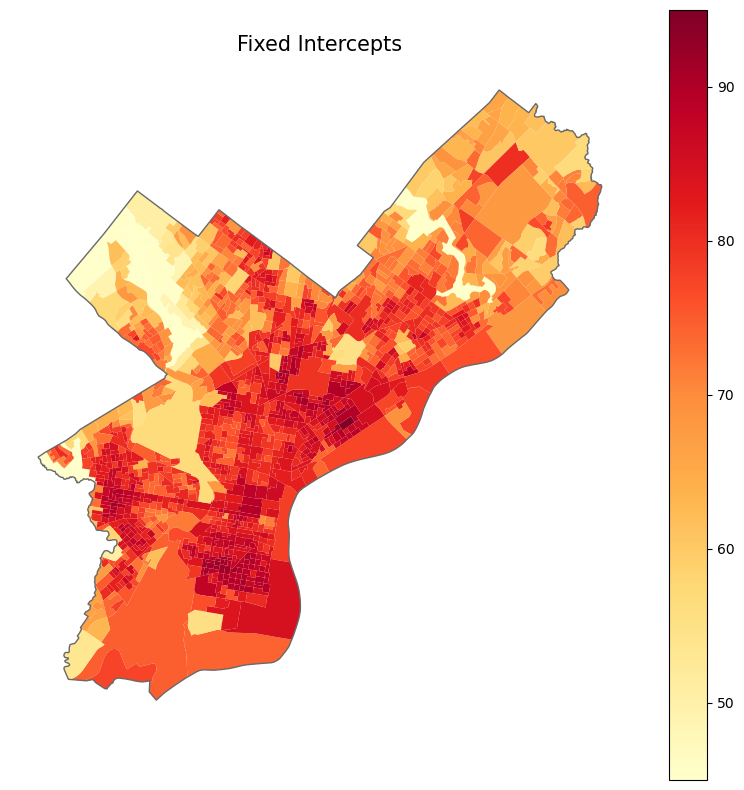

In [449]:
fig_temp, ax_temp_means = plt.subplots(figsize=(10,10))

# colors = color.LinearSegmentedColormap.from_list("temp_map", ["yellow", "orange", "red"])
phl_temp_params.plot("Intercept", ax = ax_temp_means, cmap = "YlOrRd", label="Temp", legend = True,
               norm=plt.Normalize(vmin=45, vmax=95)) 
ax_temp_means.set_title("Fixed Intercepts", fontsize=15)

city_limits.plot(ax=ax_temp_means, edgecolor="dimgray", facecolor="none", linewidth=1)
#city_means.loc[(city_means["Temp Hotspot"] == 1),:].plot(ax = ax_temp_means, edgecolor="black", facecolor="none", linewidth=0.01)


ax_temp_means.set_axis_off()
#fig_temp.savefig("Graphs/phl_temp_intercept_fe.pdf")

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


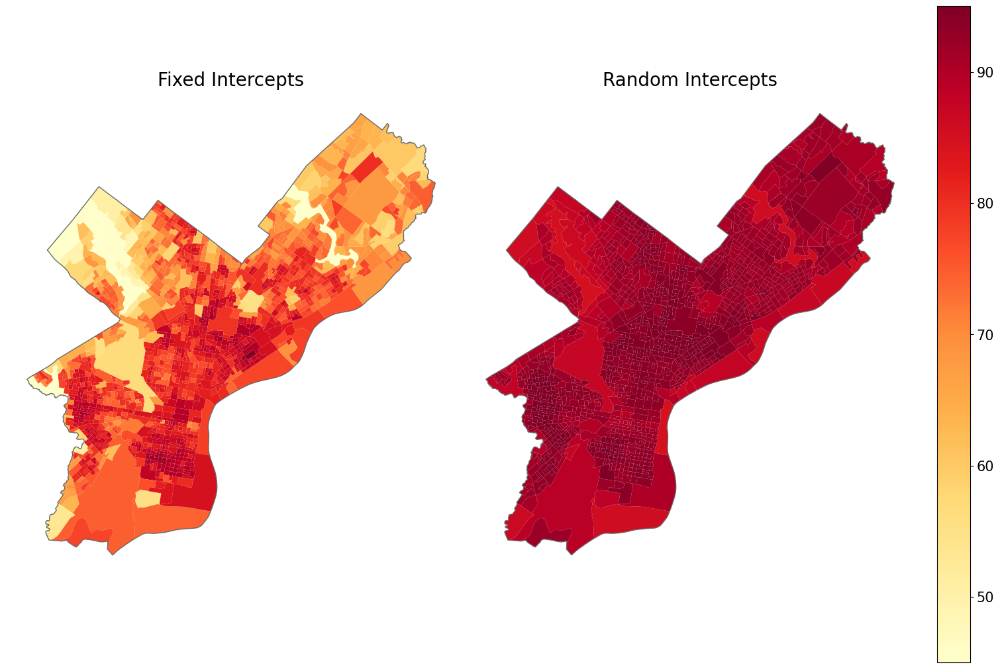

In [86]:
fig_temp_time, ax_temp_time = plt.subplots(figsize=(15,10), nrows=1, ncols=2, layout="constrained")

# Plot NDVI regions
phl_temp_params.plot("Intercept", ax = ax_temp_time[0], cmap = "YlOrRd",
                     label="Intercepts", norm=plt.Normalize(45, 95))
ax_temp_time[0].set_title("Fixed Intercepts", fontsize=20)

city_means.plot("RE Intercept", ax = ax_temp_time[1], cmap = "YlOrRd", label="RE Intercept", 
                norm=plt.Normalize(45, 95), legend=True)
ax_temp_time[1].set_title("Random Intercepts", fontsize=20)

cbar = ax_temp_time[1].figure.axes[2] 
cbar.tick_params(labelsize=15)

#phl_block_groups.plot(ax=ax_phl_ndvi[1], edgecolor="whitesmoke", facecolor="none", linewidth=0.0001)

# Format and plot city limits
for i in range(2):
    city_limits.plot(ax=ax_temp_time[i], edgecolor="dimgray", facecolor="none", linewidth=1)
    ax_temp_time[i].set_axis_off()

#fig_temp_time.suptitle("OLS Estimations from 2013-2022", fontsize=25)
#fig_temp_time.savefig("Graphs/phl_Temp_Time_intercepts.pdf")

In [399]:
alt.Chart(phl_temp_params.to_crs(4326)).mark_geoshape(stroke="gray").encode(tooltip=["Intercept:Q", "Time Slope:Q",
                                                                                        "OBJECTID:N"],
                                                                color=alt.Color("Intercept:Q", 
                                                                                scale=alt.Scale(scheme="inferno")),
                                                               ).properties(width=500, height=500)

alt.Chart(...)

C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):
C:\Users\kelly\OneDrive\Documents\Anaconda\envs\research\Lib\site-packages\geopandas\plotting.py:732: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(values.dtype):


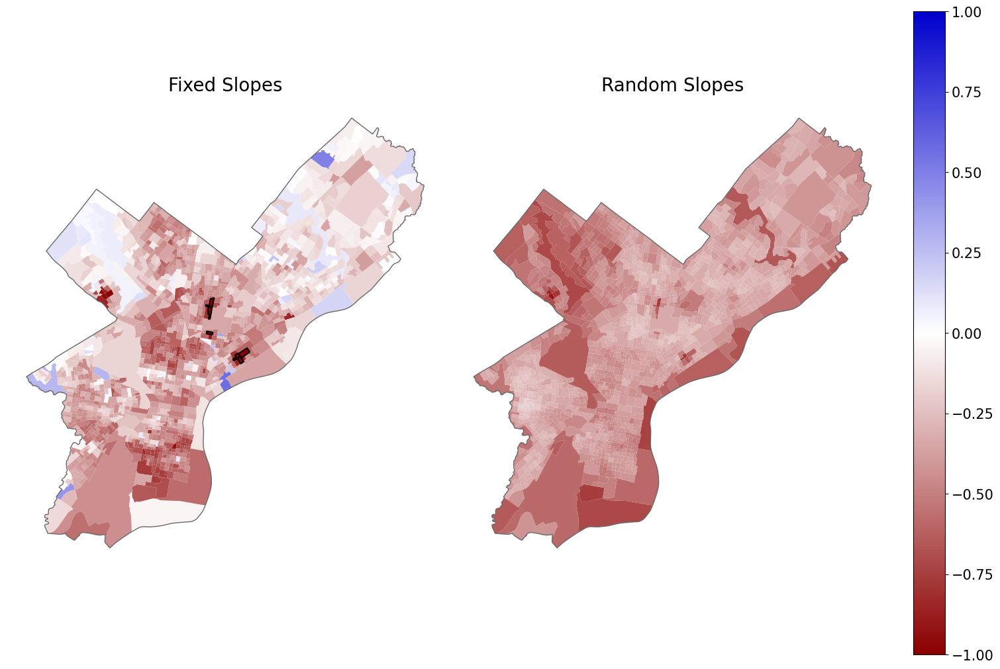

In [79]:
fig_temp_time, ax_temp_time = plt.subplots(figsize=(15,10), nrows=1, ncols=2, layout="constrained")

# Plot NDVI regions
colors = color.LinearSegmentedColormap.from_list("ndvi_map", ["darkred", "White", "mediumblue"])
phl_temp_params.plot("Time Slope", ax = ax_temp_time[0], cmap = colors,
                     label="Slopes", norm=plt.Normalize(-1, 1))
ax_temp_time[0].set_title("Fixed Slopes", fontsize=20)

city_means.plot("RE Time", ax = ax_temp_time[1], cmap = colors, label="Sig Slopes", 
                     norm=plt.Normalize(-1, 1), legend=True)
ax_temp_time[1].set_title("Random Slopes", fontsize=20)

cbar = ax_temp_time[1].figure.axes[2] 
cbar.tick_params(labelsize=15)

#phl_block_groups.plot(ax=ax_phl_ndvi[1], edgecolor="whitesmoke", facecolor="none", linewidth=0.0001)

# Format and plot city limits
for i in range(2):
    city_limits.plot(ax=ax_temp_time[i], edgecolor="dimgray", facecolor="none", linewidth=1)
    ax_temp_time[i].set_axis_off()
phl_temp_params.sort_values(["Sig Time Slope"])[0:6].plot(ax=ax_temp_time[0], edgecolor="black", facecolor="none", linewidth=1.5)

#fig_temp_time.suptitle("OLS Estimations from 2013-2022", fontsize=25)
#fig_temp_time.savefig("Graphs/phl_Temp_Time_slopes.pdf")

In [422]:
phl_temp_params.sort_values(["Sig Time Slope"])[0:7]

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,Shape__Area,Shape__Length,geometry,Intercept,Time Slope,Sig Time Slope,NDVI
261,262,42,101,028700,2,421010287002,Block Group 2,G5030,S,167683,0,+40.0216674,-075.1296939,1.729916e+06,7215.682726,"POLYGON ((489044.902 4430045.994, 489001.476 4...",89.502870,-1.501368,-1.501368,70.632862
539,540,42,101,017900,2,421010179002,Block Group 2,G5030,S,105786,0,+39.9877602,-075.1087679,1.138664e+06,5341.591351,"POLYGON ((490816.245 4426339.763, 490748.571 4...",91.258562,-1.452712,-1.452712,70.632862
627,628,42,101,038200,2,421010382002,Block Group 2,G5030,S,250653,0,+39.9901972,-075.1026825,2.697944e+06,7030.966256,"POLYGON ((491630.483 4426735.836, 491537.101 4...",95.437619,-1.389891,-1.389891,70.632862
721,722,42,101,019502,3,421010195023,Block Group 3,G5030,S,72147,0,+40.0026911,-075.1309215,7.765713e+05,3920.024072,"POLYGON ((489022.510 4427945.728, 488977.026 4...",91.223336,-1.241241,-1.241241,70.632862
724,725,42,101,038300,2,421010383002,Block Group 2,G5030,S,159019,0,+40.0160234,-075.1307818,1.711613e+06,7297.200535,"POLYGON ((488854.994 4429023.247, 488845.950 4...",87.495438,-1.114573,-1.114573,70.632862
611,612,42,101,018002,1,421010180021,Block Group 1,G5030,S,111954,0,+39.9857439,-075.1056803,1.205044e+06,4567.558534,"POLYGON ((490854.080 4426137.493, 490850.585 4...",89.393930,-1.041543,-1.041543,70.632862
0,1,42,101,010800,1,421010108001,Block Group 1,G5030,S,161887,0,+39.9687580,-075.1997251,1.742508e+06,8200.327170,"POLYGON ((483047.282 4424385.239, 483138.583 4...",79.383717,-0.406550,-0.000000,70.632862


In [89]:
city_means["RE Intercept"].describe()

count    1336.000000
mean       92.716448
std         1.792307
min        84.485399
25%        91.792658
50%        92.836241
75%        93.947325
max        96.299750
Name: RE Intercept, dtype: float64